In [1]:
import torchvision
from torchvision import transforms, datasets, utils
import torch as torch
import matplotlib.pyplot as plt
import torch.nn as nn
from tqdm.notebook import tqdm
from torch.utils.data import Dataset, DataLoader
from pathlib import Path
from PIL import Image
import itertools
import time
import numpy as np
from torchvision.utils import save_image

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [3]:
class AverageMeter(object):
    def __init__(self):
        self.avg = 0
        self.sum = 0
        self.count = 0 

    def update(self, val, n=1):
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

In [4]:
mean,std=(0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
compose = transforms.Compose([
    transforms.Resize(64),
    transforms.CenterCrop(64),
    transforms.RandomHorizontalFlip(),   
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std)
])

dataset = torchvision.datasets.CelebA('celeba',split='train',target_type='attr', transform=compose, download=True)

Files already downloaded and verified


In [5]:
bs = 128
dataloader = torch.utils.data.DataLoader(dataset, batch_size=bs, shuffle=False,num_workers=4)

In [6]:
def mymshow(img, std, mean, fig_size=[8,8]):
    img = img.permute(1,2,0).cpu()
    img = img * torch.tensor(std) + torch.tensor(mean)
    fig,ax = plt.subplots()
    fig.set_size_inches(*fig_size)
    ax.imshow(img)
    plt.show()

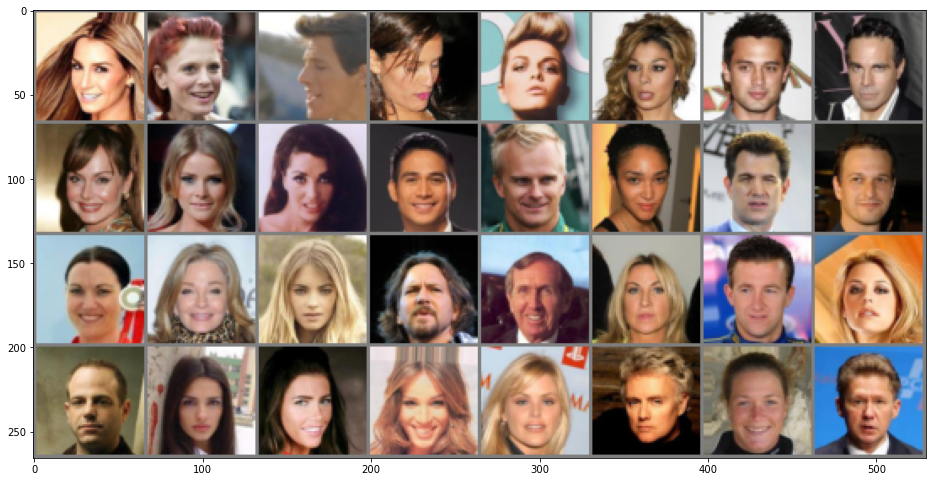

In [7]:
batch = next(iter(dataloader))
mymshow(utils.make_grid(batch[0][:32],nrow=8), std, mean,[16,16])

In [8]:
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

In [9]:
def gen_block(input_channels, output_channels, kernel_size, stride, padding, final_layer=False):
    if not final_layer:
        return nn.Sequential(
            nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride,padding),
            nn.BatchNorm2d(output_channels),
            nn.ReLU(True))
    else:
        return nn.Sequential(
            nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride,padding),     
            nn.Tanh())

class Generator(nn.Module):
    def __init__(self, z_dim):
        super(Generator, self).__init__()
        self.layers = nn.Sequential(
            gen_block(z_dim,1024,4,1,0),
            gen_block(1024,512,4,2,1),
            gen_block(512,256,4,2,1),
            gen_block(256,128,4,2,1),
            gen_block(128,3,4,2,1,final_layer=True))
        weights_init(self.layers)
    
    def forward(self, noise):
        return self.layers(noise)

In [10]:
def hook(module, input, output):
    if type(module) != nn.Sequential:
        print(f'{module.__class__.__name__:<15} {str([*input[0].shape]):<20} --> {[*output.shape]}')

def print_layers(module, input_shape):
    handles = []
    module.apply(lambda l: handles.append(l.register_forward_hook(hook)));
    module(torch.randn(*input_shape));
    [h.remove() for h in handles]

In [11]:
print_layers(Generator(128),[64,128,1,1])

ConvTranspose2d [64, 128, 1, 1]      --> [64, 1024, 4, 4]
BatchNorm2d     [64, 1024, 4, 4]     --> [64, 1024, 4, 4]
ReLU            [64, 1024, 4, 4]     --> [64, 1024, 4, 4]
ConvTranspose2d [64, 1024, 4, 4]     --> [64, 512, 8, 8]
BatchNorm2d     [64, 512, 8, 8]      --> [64, 512, 8, 8]
ReLU            [64, 512, 8, 8]      --> [64, 512, 8, 8]
ConvTranspose2d [64, 512, 8, 8]      --> [64, 256, 16, 16]
BatchNorm2d     [64, 256, 16, 16]    --> [64, 256, 16, 16]
ReLU            [64, 256, 16, 16]    --> [64, 256, 16, 16]
ConvTranspose2d [64, 256, 16, 16]    --> [64, 128, 32, 32]
BatchNorm2d     [64, 128, 32, 32]    --> [64, 128, 32, 32]
ReLU            [64, 128, 32, 32]    --> [64, 128, 32, 32]
ConvTranspose2d [64, 128, 32, 32]    --> [64, 3, 64, 64]
Tanh            [64, 3, 64, 64]      --> [64, 3, 64, 64]
Generator       [64, 128, 1, 1]      --> [64, 3, 64, 64]


In [12]:
def critic_block(input_channels, output_channels, kernel_size, stride, padding, final_layer=False):
    if not final_layer:
        return nn.Sequential(
            nn.Conv2d(input_channels, output_channels, kernel_size, stride, padding),
            nn.BatchNorm2d(output_channels),
            nn.LeakyReLU(0.2, True))
    else:
        return nn.Sequential(
            nn.Conv2d(input_channels, output_channels, kernel_size, stride, padding))

class Critic(nn.Module):
    def __init__(self):
        super(Critic, self).__init__()
        self.layers = nn.Sequential(
            critic_block(3,128,4,2,1),
            critic_block(128,256,4,2,1),
            critic_block(256,512,4,2,1),
            critic_block(512,1024,4,2,1),
            critic_block(1024,1,4,1,0,final_layer=True))
        weights_init(self.layers)
    
    def forward(self, noise):
        return self.layers(noise)

In [13]:
print_layers(Critic(),[64,3,64,64])

Conv2d          [64, 3, 64, 64]      --> [64, 128, 32, 32]
BatchNorm2d     [64, 128, 32, 32]    --> [64, 128, 32, 32]
LeakyReLU       [64, 128, 32, 32]    --> [64, 128, 32, 32]
Conv2d          [64, 128, 32, 32]    --> [64, 256, 16, 16]
BatchNorm2d     [64, 256, 16, 16]    --> [64, 256, 16, 16]
LeakyReLU       [64, 256, 16, 16]    --> [64, 256, 16, 16]
Conv2d          [64, 256, 16, 16]    --> [64, 512, 8, 8]
BatchNorm2d     [64, 512, 8, 8]      --> [64, 512, 8, 8]
LeakyReLU       [64, 512, 8, 8]      --> [64, 512, 8, 8]
Conv2d          [64, 512, 8, 8]      --> [64, 1024, 4, 4]
BatchNorm2d     [64, 1024, 4, 4]     --> [64, 1024, 4, 4]
LeakyReLU       [64, 1024, 4, 4]     --> [64, 1024, 4, 4]
Conv2d          [64, 1024, 4, 4]     --> [64, 1, 1, 1]
Critic          [64, 3, 64, 64]      --> [64, 1, 1, 1]


In [14]:
def calc_gp(critic, real_images, fake_images):

    epsilon = torch.rand(len(real_images), 1, 1, 1, device=device, requires_grad=True)

    mixed_images = real_images * epsilon + fake_images * (1 - epsilon)
    mixed_scores = critic(mixed_images)
    
    gradient = torch.autograd.grad(
        inputs=mixed_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]

    gradient = gradient.view(len(gradient), -1)

    gradient_norm = gradient.norm(2, dim=1)

    penalty = torch.mean((gradient_norm-1)**2)

    return penalty

In [15]:
n_epochs=100
beta_1 = 0.5
beta_2 = 0.999
lr=0.0002
display_step = 500
z_dim = 100
c_lambda = 10
n_critic = 5

In [16]:
generator = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(generator.parameters(), lr=lr, betas=(beta_1, beta_2))
critic = Critic().to(device)
critic_opt = torch.optim.Adam(critic.parameters(), lr=lr, betas=(beta_1, beta_2))

Step 500: Generator loss: 447.7055416862563, critic loss: -787.0839181139083


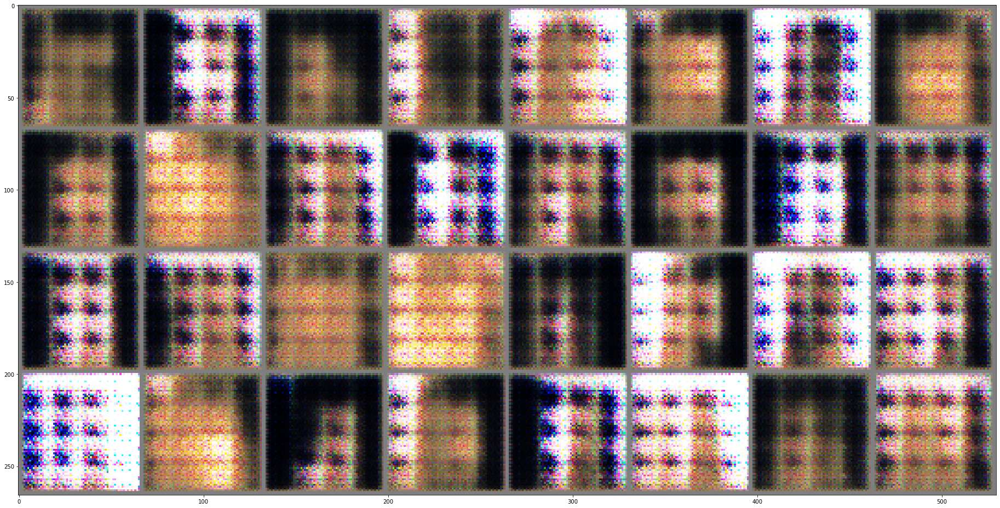

Step 1000: Generator loss: 372.7607312842981, critic loss: -399.543527669959


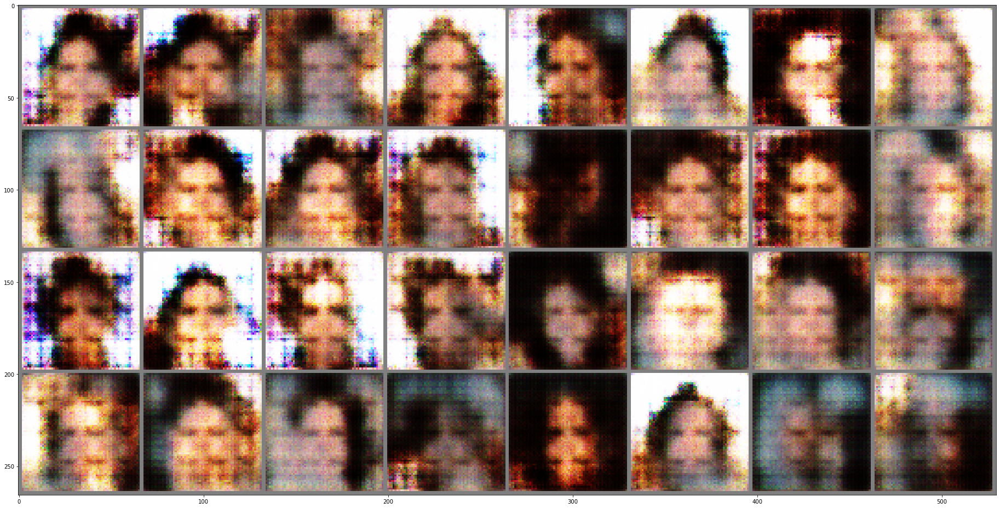


Epoch 0: Generator loss: 351.49320178312416, critic loss: -317.2389744767922


Step 1500: Generator loss: 336.64003758097806, critic loss: -270.69496886453476


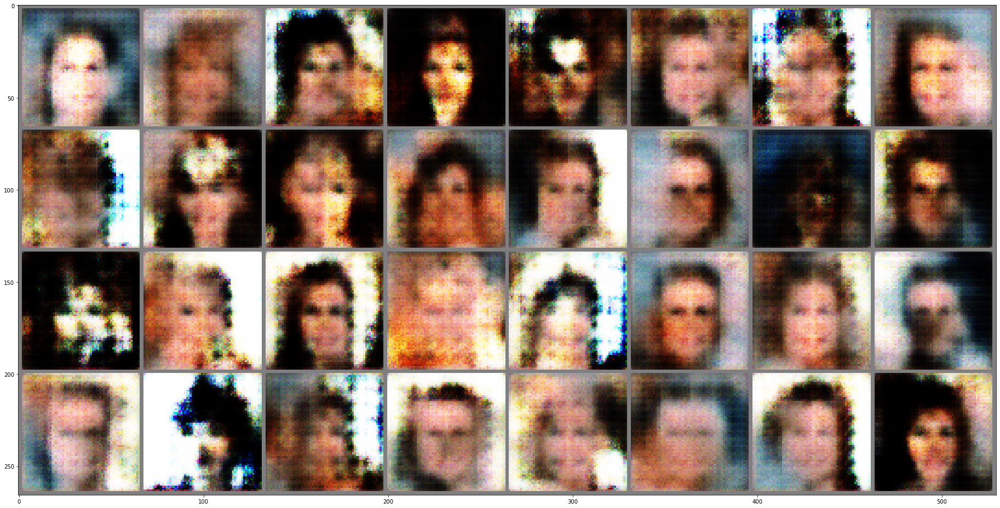

Step 2000: Generator loss: 311.8535025494354, critic loss: -205.73209687024712


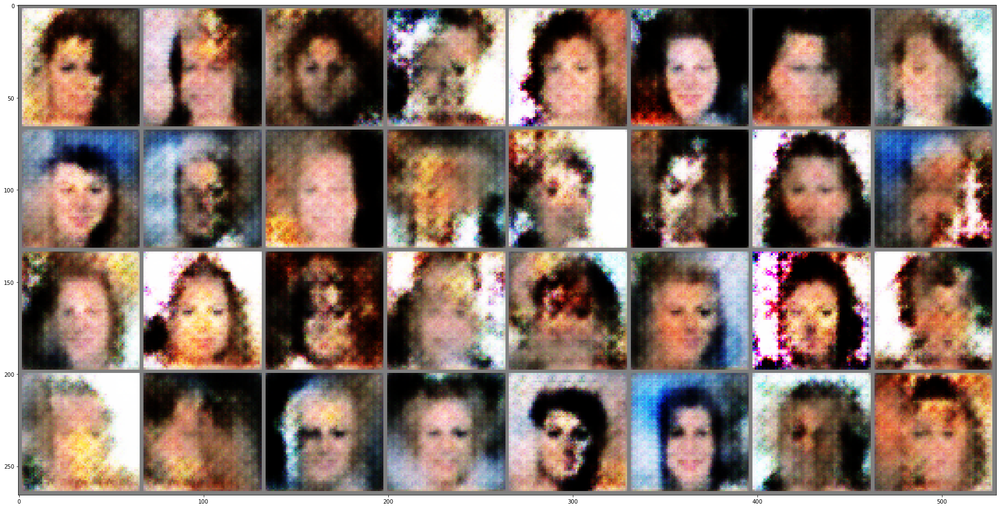

Step 2500: Generator loss: 292.70088985770525, critic loss: -166.62476391950537


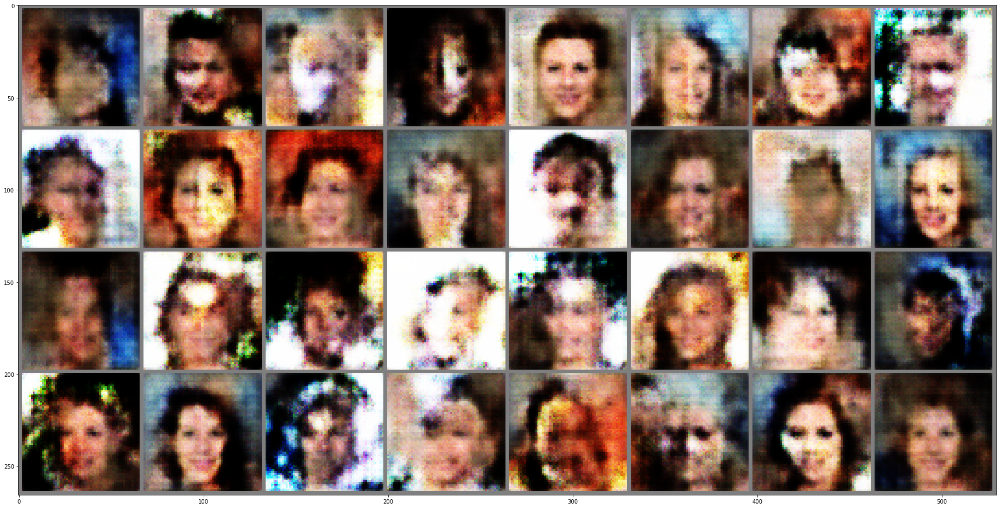


Epoch 1: Generator loss: 291.35000104847967, critic loss: -163.99517383616453


Step 3000: Generator loss: 276.65300445747056, critic loss: -140.48266841261963


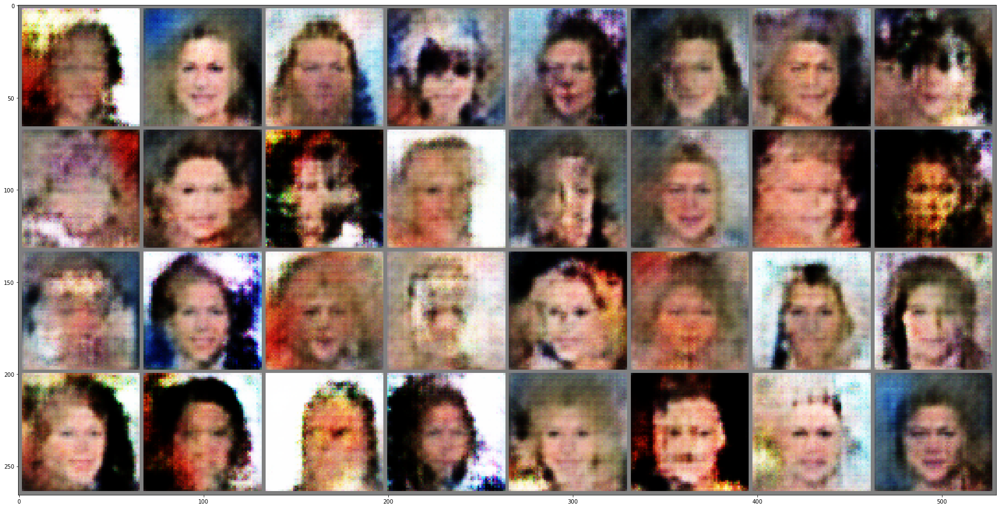

Step 3500: Generator loss: 263.35226954951264, critic loss: -121.69780800520913


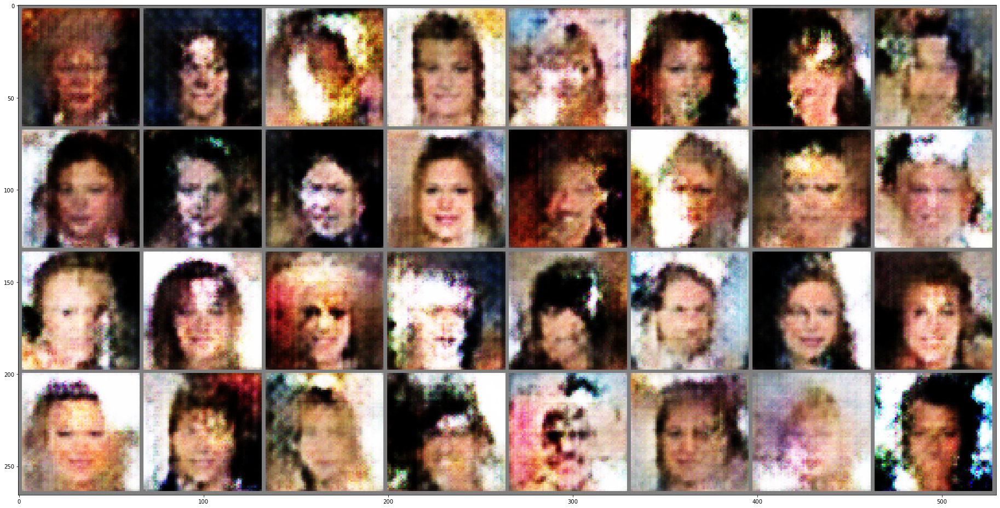


Epoch 2: Generator loss: 256.1926491118228, critic loss: -112.40042777007461


Step 4000: Generator loss: 252.30204407090858, critic loss: -107.5802295738944


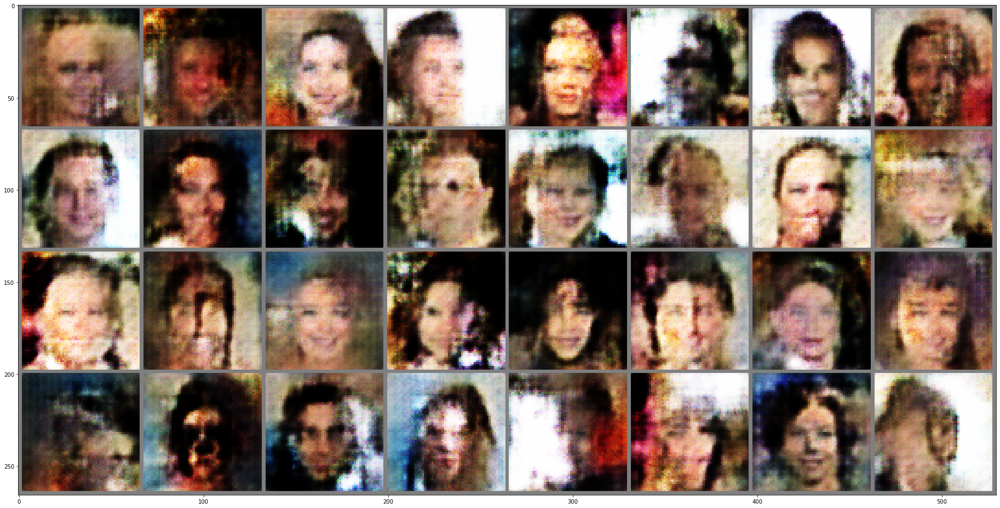

Step 4500: Generator loss: 243.29758582830996, critic loss: -96.55783329203398


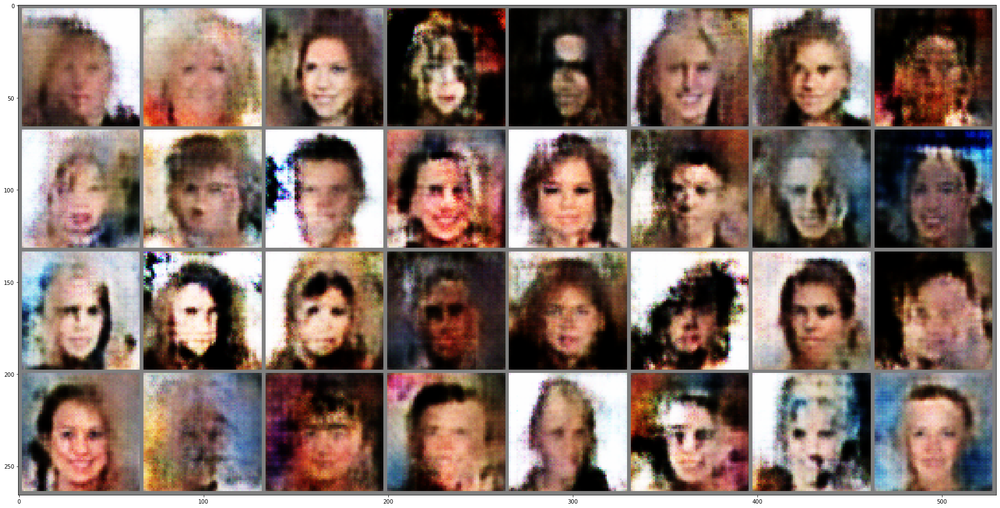

Step 5000: Generator loss: 235.84184105450885, critic loss: -87.71469461523624


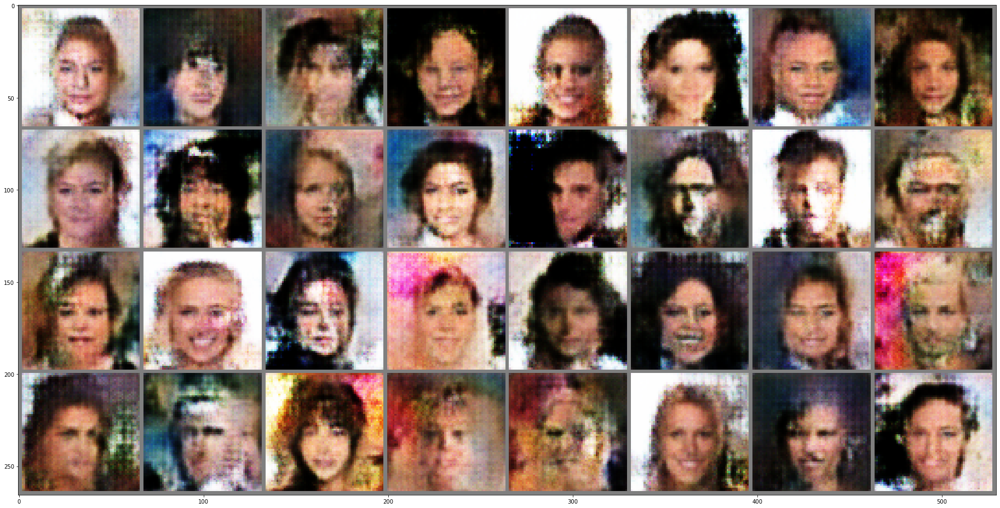


Epoch 3: Generator loss: 234.7615055793587, critic loss: -86.34479319748425


Step 5500: Generator loss: 230.1595521623804, critic loss: -80.3742858026016


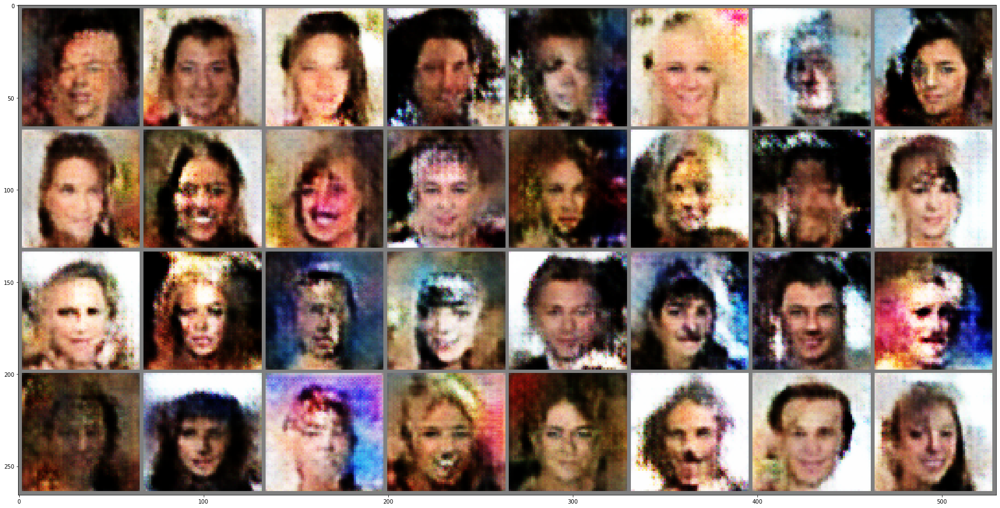

Step 6000: Generator loss: 224.5648863857664, critic loss: -74.33804421817763


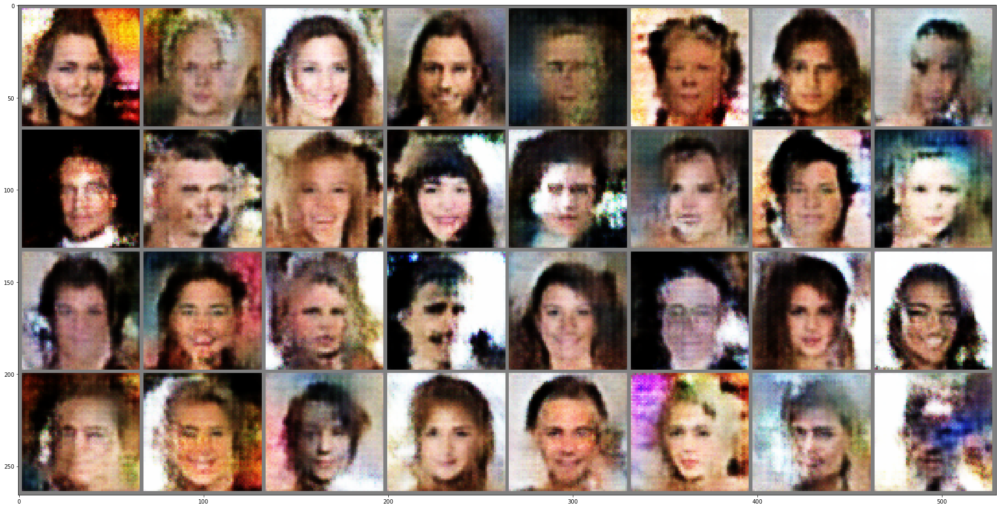


Epoch 4: Generator loss: 220.9926268565682, critic loss: -70.49084528625923


Step 6500: Generator loss: 219.63310361399718, critic loss: -69.09320565253891


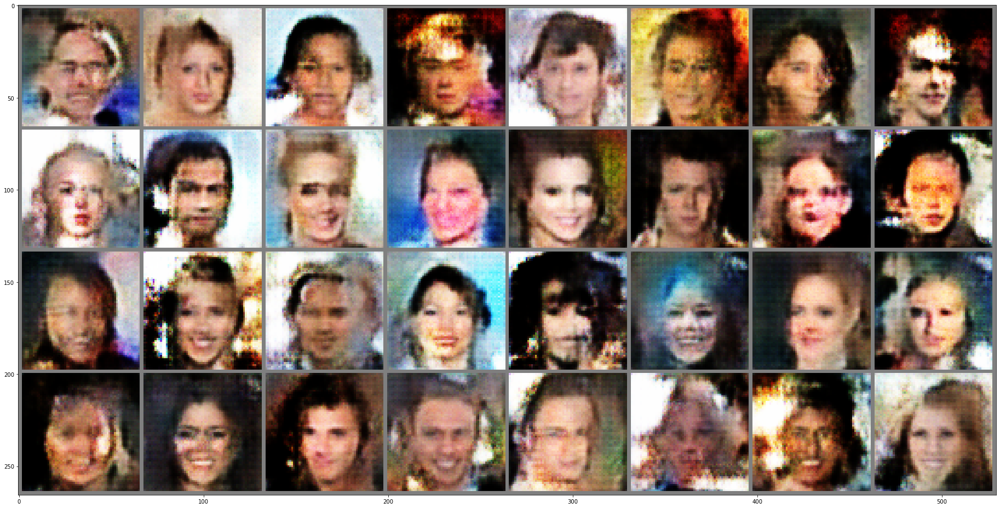

Step 7000: Generator loss: 214.7556920866455, critic loss: -64.71716690851625


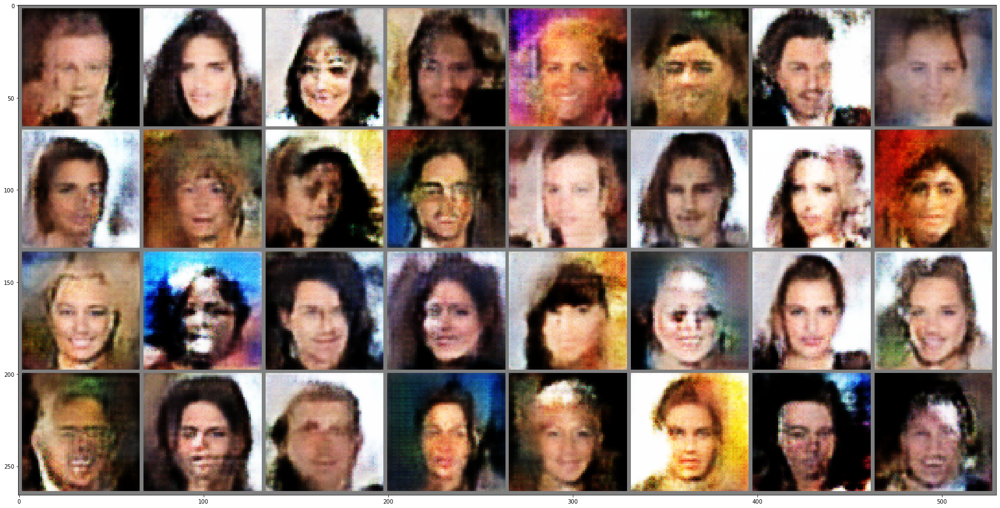

Step 7500: Generator loss: 210.20253814536164, critic loss: -60.90195727234322


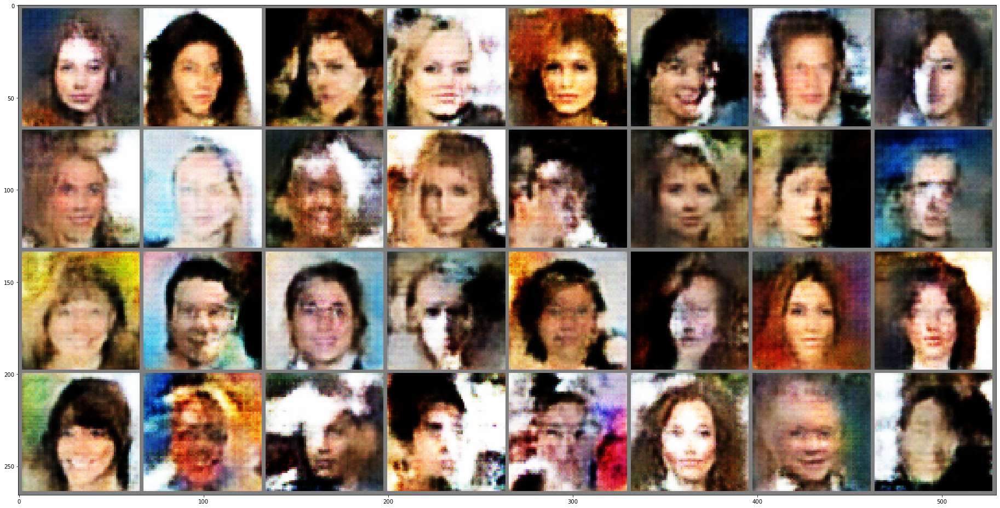


Epoch 5: Generator loss: 209.14055946474645, critic loss: -59.97332914909943


Step 8000: Generator loss: 206.1178604121359, critic loss: -57.55426627022649


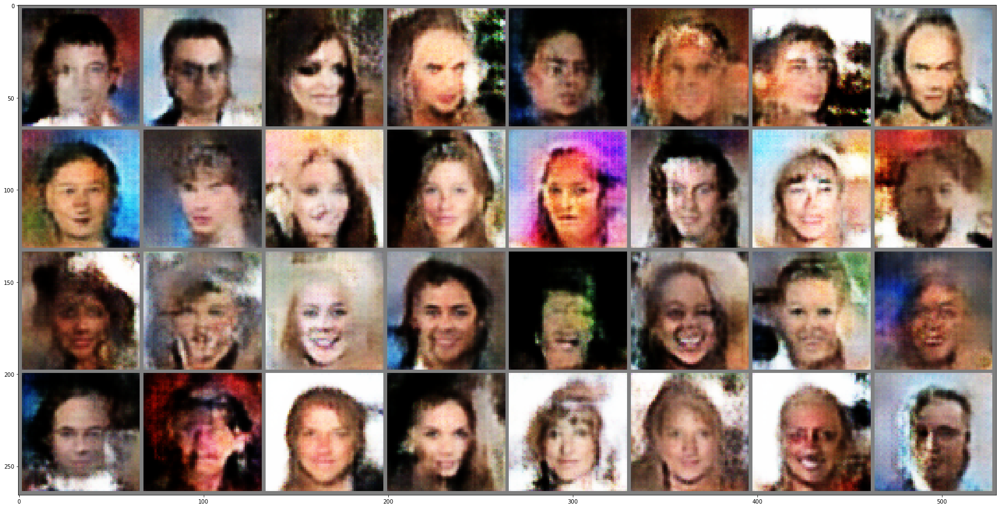

Step 8500: Generator loss: 202.2510750361616, critic loss: -54.54856568673902


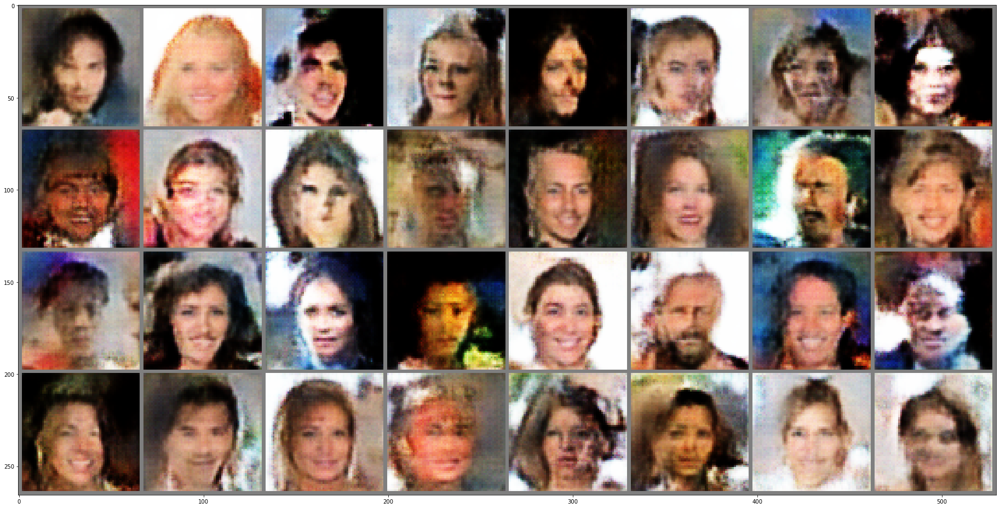


Epoch 6: Generator loss: 199.45509244598966, critic loss: -52.395950611241624


Step 9000: Generator loss: 198.74977936610088, critic loss: -51.908531512304954


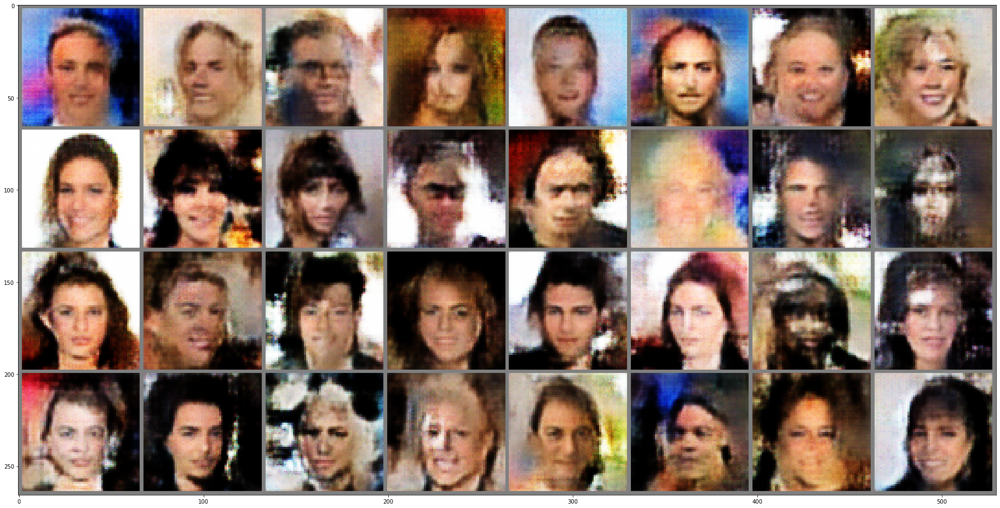

Step 9500: Generator loss: 194.88959761639083, critic loss: -49.530807063300486


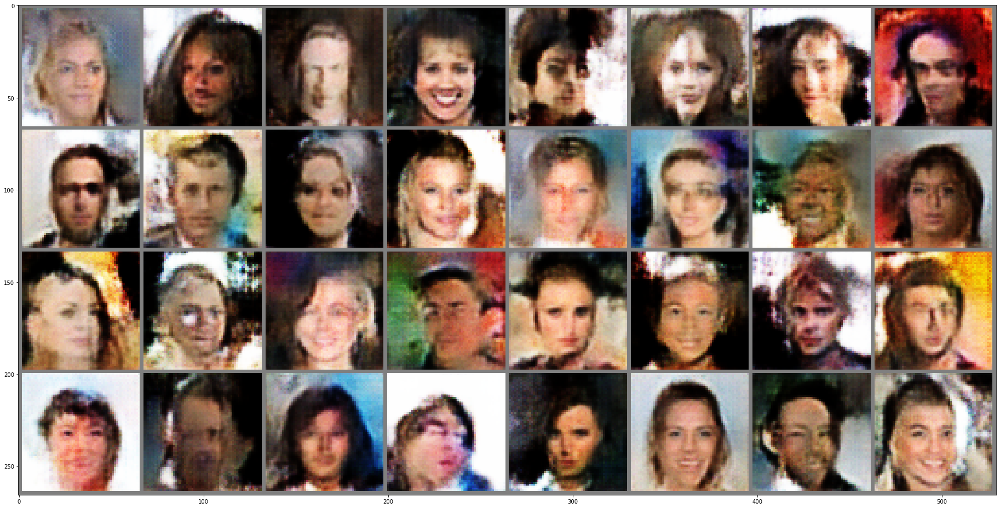

Step 10000: Generator loss: 191.5761983916462, critic loss: -47.28969028469496


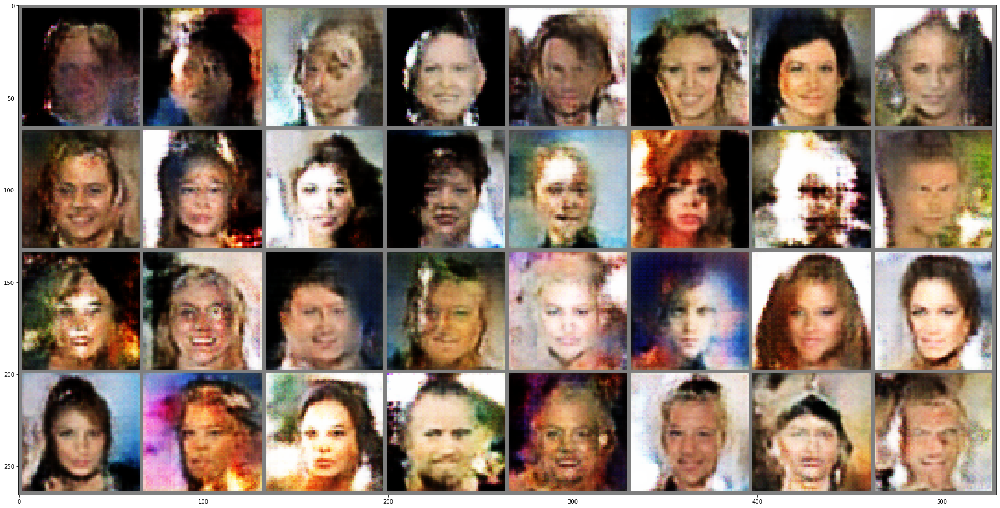


Epoch 7: Generator loss: 190.62331686799044, critic loss: -46.53917705080847


Step 10500: Generator loss: 188.94002546217823, critic loss: -45.26144777074019


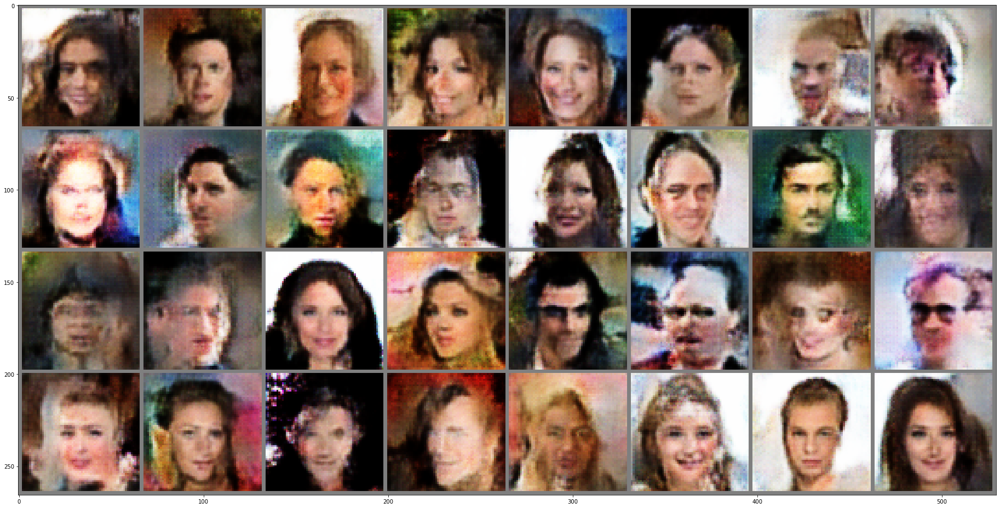

Step 11000: Generator loss: 186.39580157458394, critic loss: -43.53726221948224


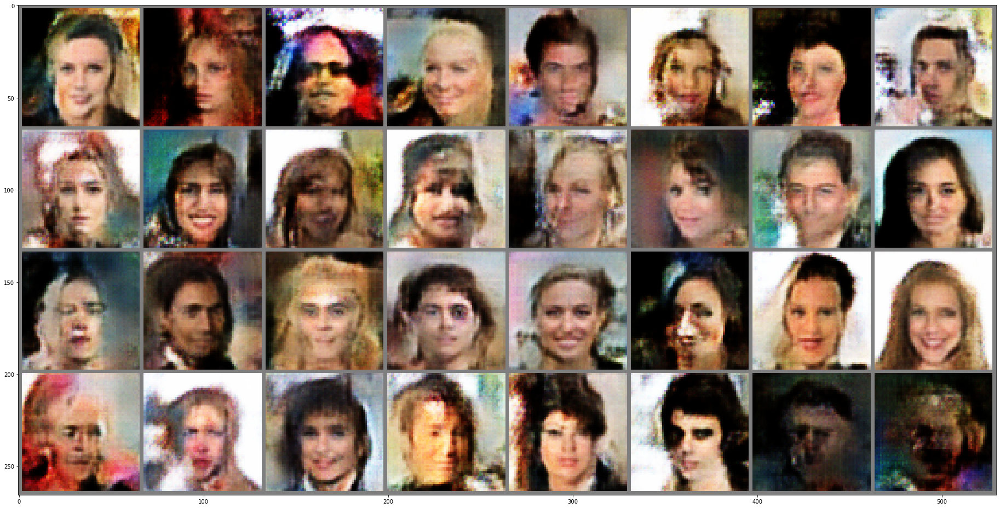


Epoch 8: Generator loss: 183.8231289390492, critic loss: -42.124175153836475


Step 11500: Generator loss: 183.48787915575295, critic loss: -41.968188041095246


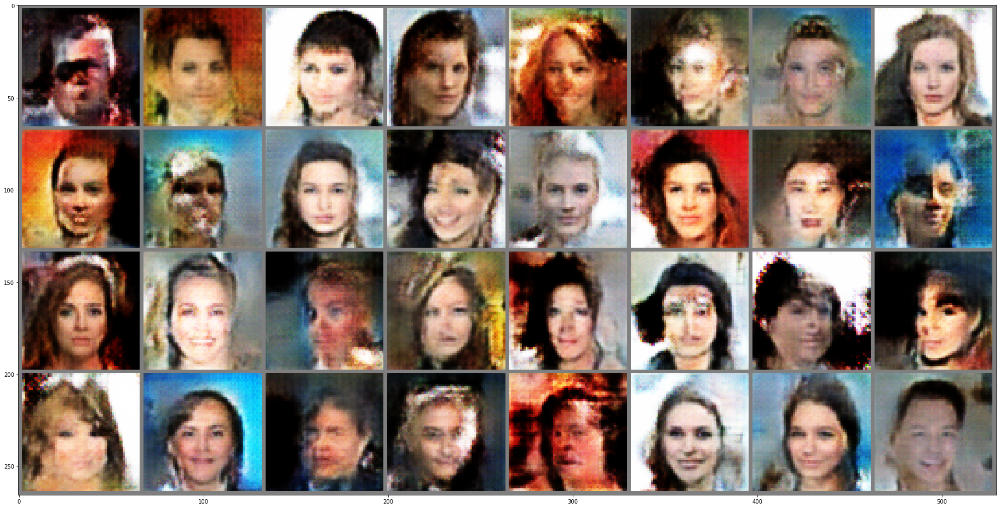

Step 12000: Generator loss: 180.63042070314074, critic loss: -40.511560625559106


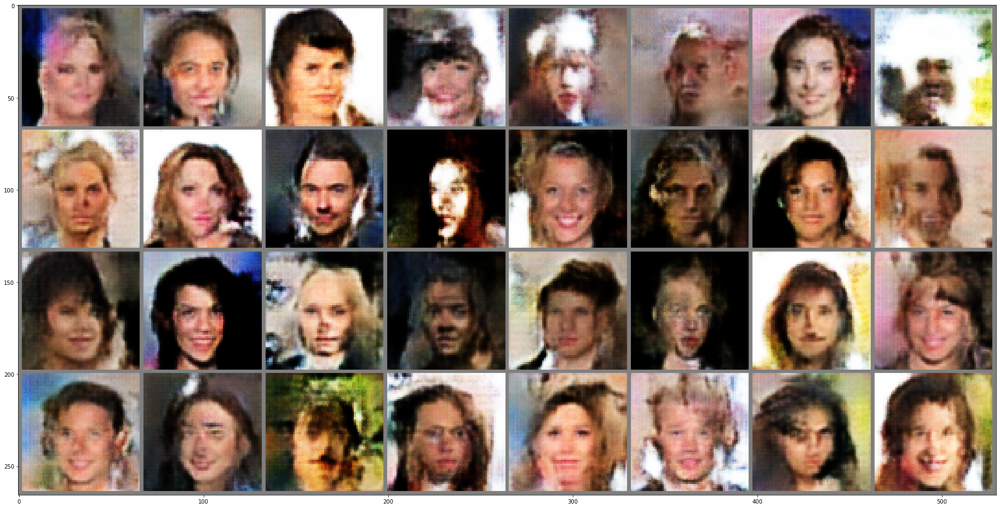

Step 12500: Generator loss: 178.01198149691115, critic loss: -39.17948679699458


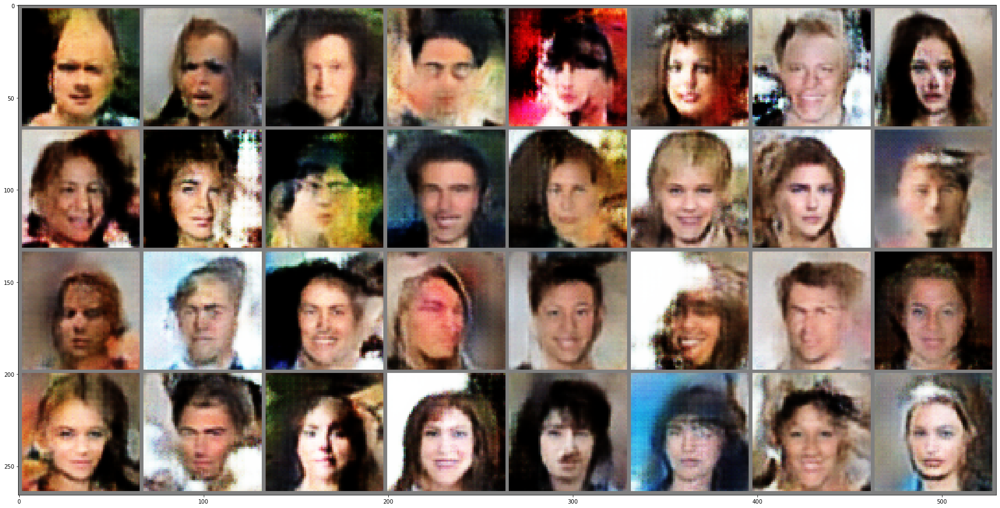


Epoch 9: Generator loss: 176.46514318215068, critic loss: -38.568516460538106


Step 13000: Generator loss: 174.40818910777892, critic loss: -37.83583704180945


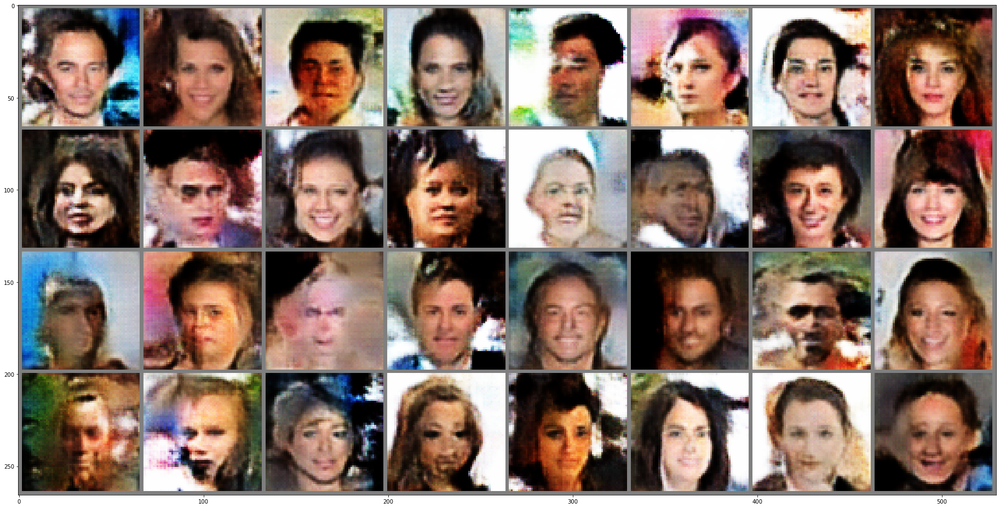

Step 13500: Generator loss: 171.02911123328667, critic loss: -36.66654174885211


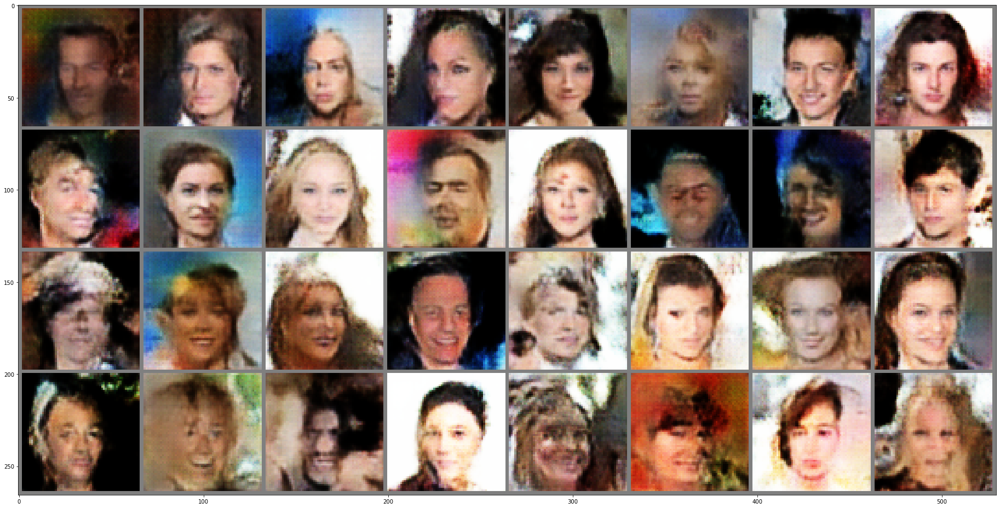


Epoch 10: Generator loss: 168.1075764967426, critic loss: -35.62603293223901


Step 14000: Generator loss: 168.04733299448895, critic loss: -35.6073199188121


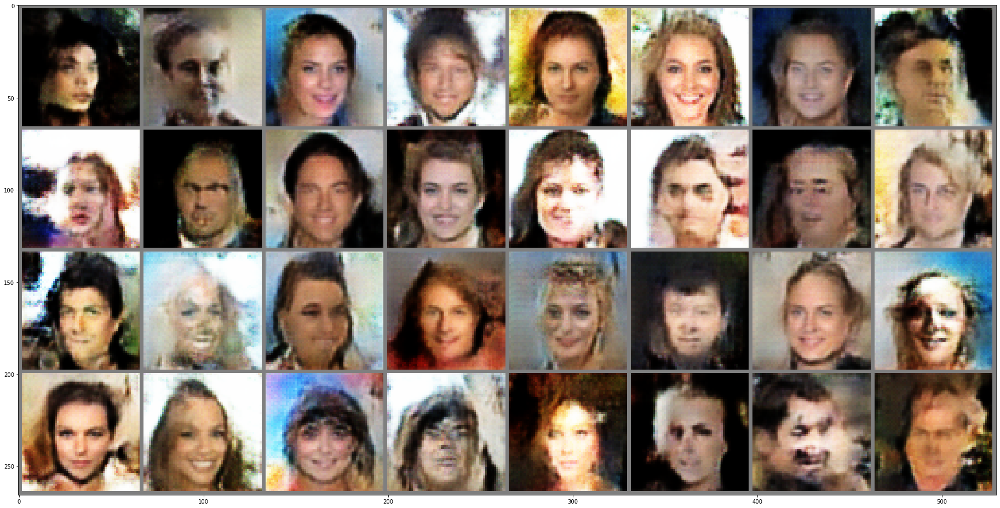

Step 14500: Generator loss: 165.17788454531404, critic loss: -34.45172711744281


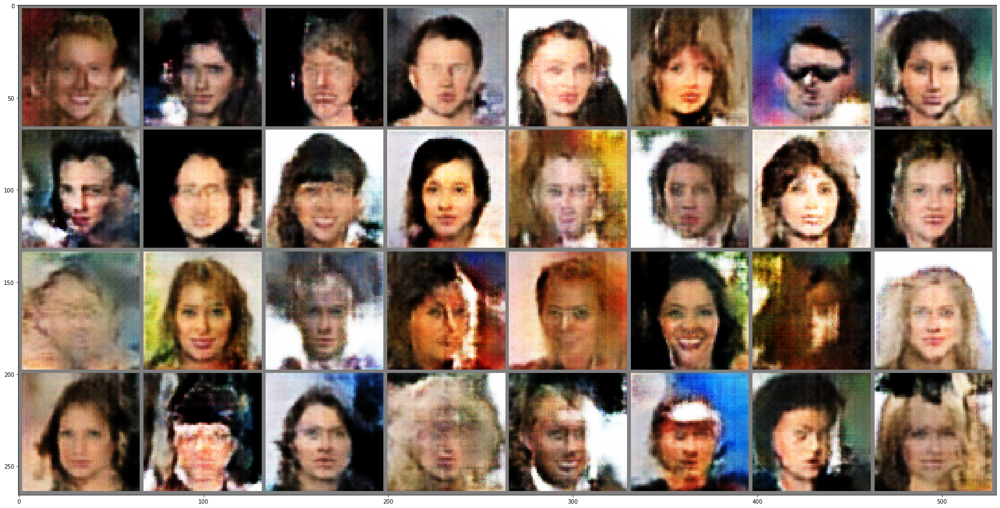

Step 15000: Generator loss: 162.5492267224626, critic loss: -33.379753721706244


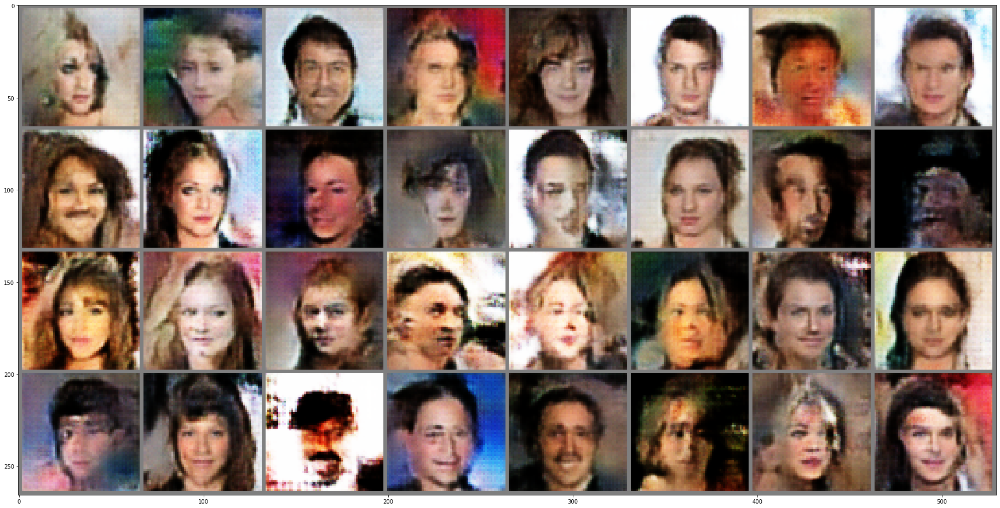


Epoch 11: Generator loss: 161.3274324077778, critic loss: -32.85862654406908


Step 15500: Generator loss: 160.24684142089748, critic loss: -32.418329838130944


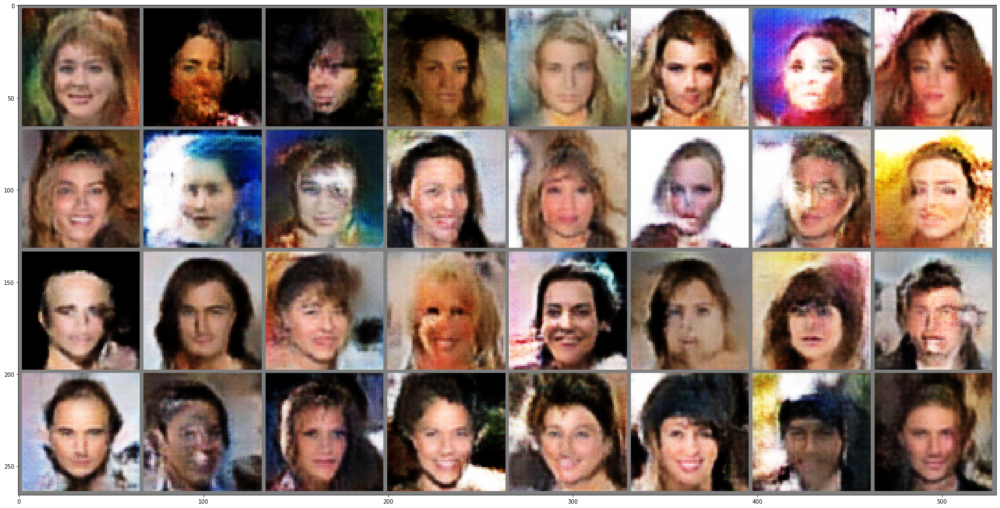

Step 16000: Generator loss: 158.11745164121734, critic loss: -31.565598393212035


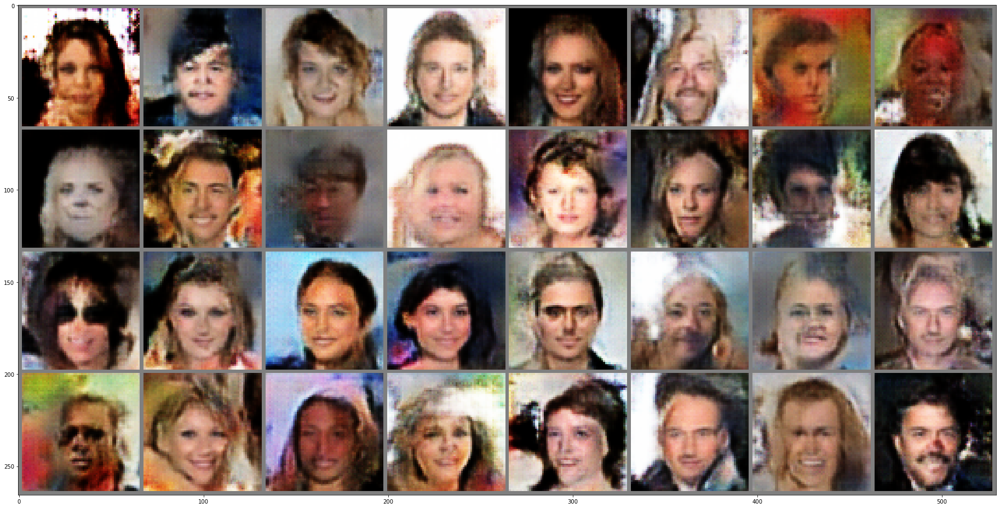

Step 16500: Generator loss: 155.9877224319782, critic loss: -30.80599597768722


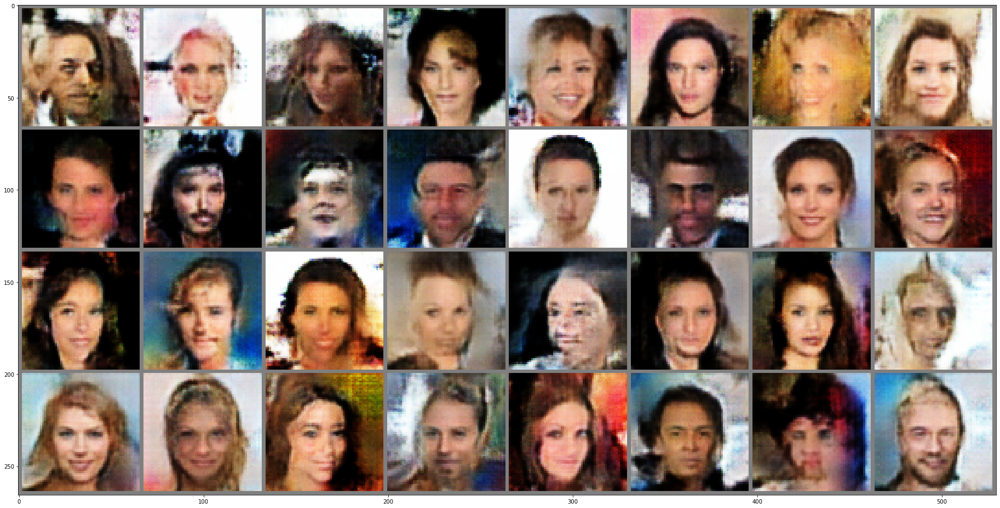


Epoch 12: Generator loss: 155.84415780594097, critic loss: -30.75401707962369


Step 17000: Generator loss: 153.80512284637578, critic loss: -30.091933673865956


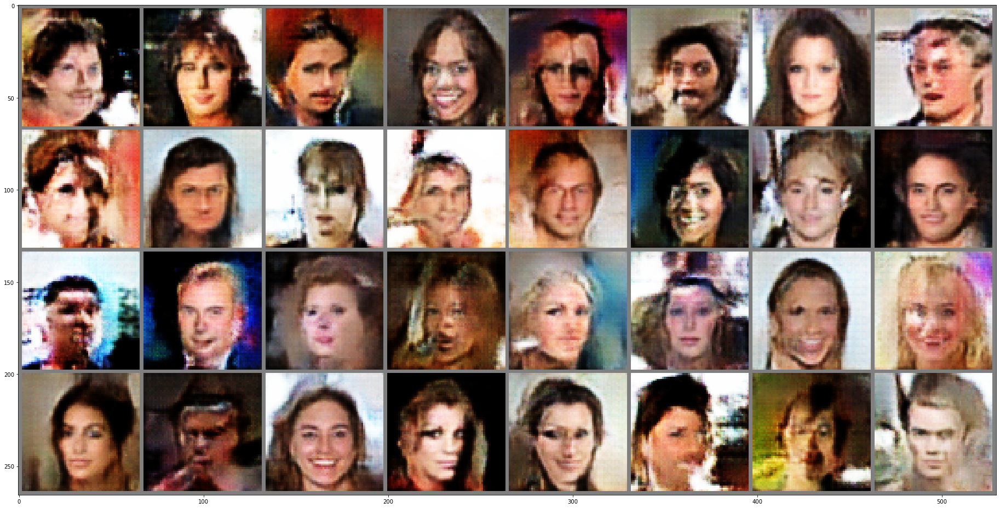

Step 17500: Generator loss: 151.5622576030371, critic loss: -29.413958644772833


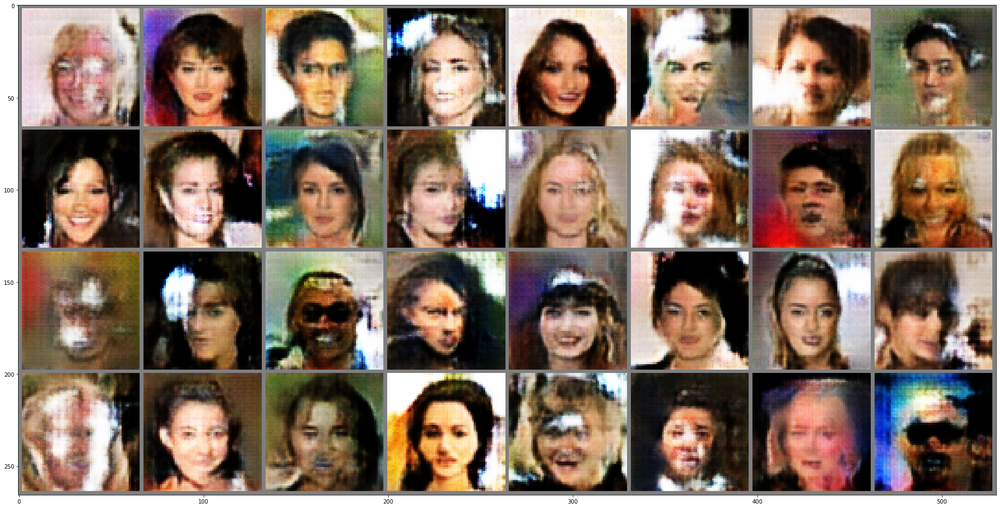


Epoch 13: Generator loss: 150.25510822500505, critic loss: -29.00955641550352


Step 18000: Generator loss: 149.4143912098283, critic loss: -28.767506966966252


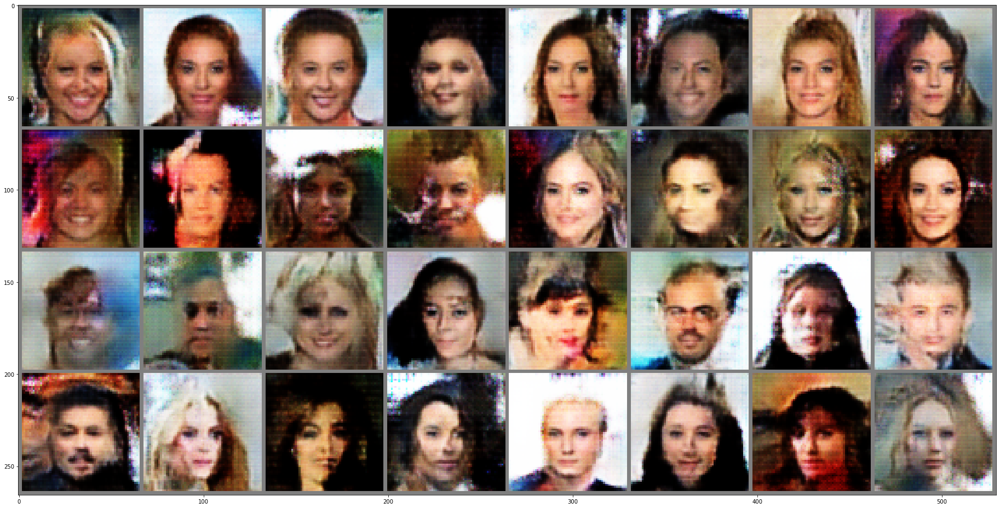

Step 18500: Generator loss: 147.45687786168264, critic loss: -28.115204863157693


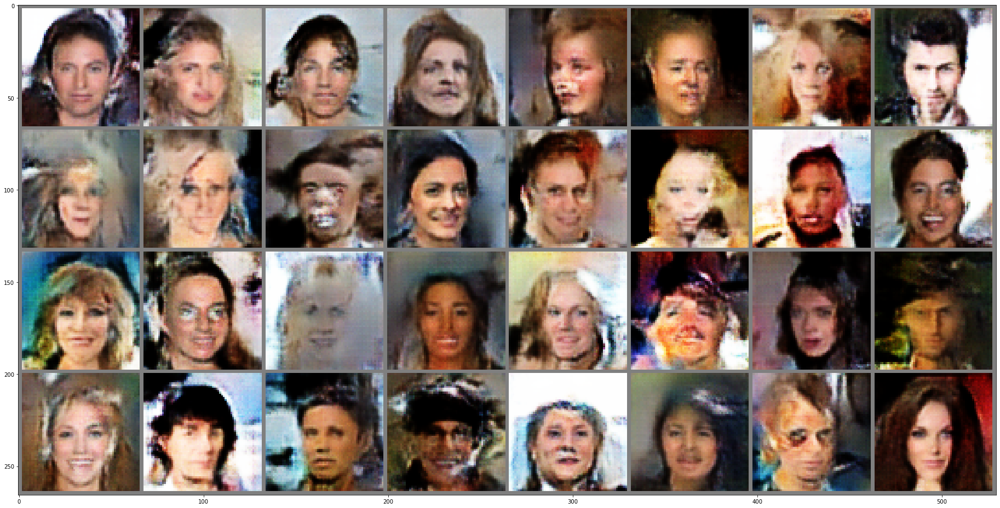

Step 19000: Generator loss: 145.52238152268544, critic loss: -27.5001819561846


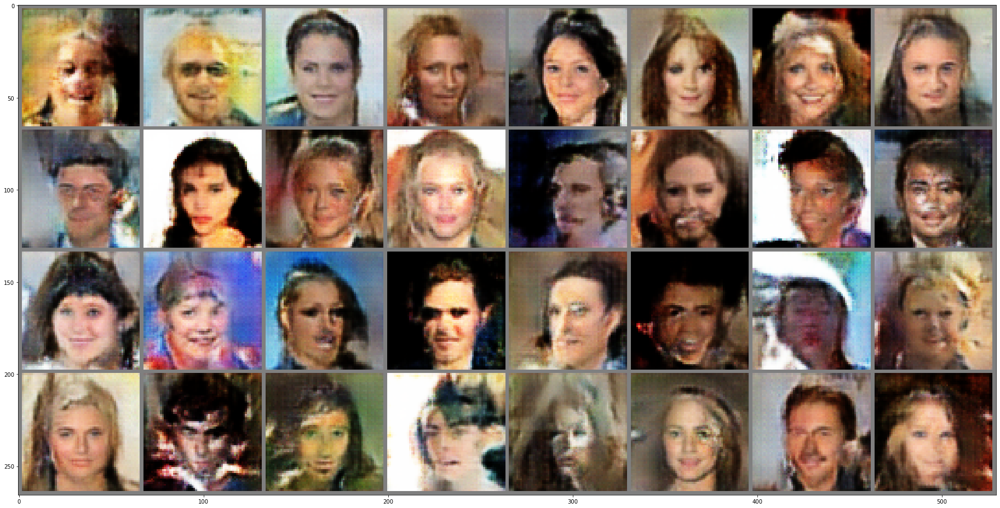


Epoch 14: Generator loss: 145.2456024977062, critic loss: -27.42178229812313


Step 19500: Generator loss: 143.585938709754, critic loss: -26.982063582869888


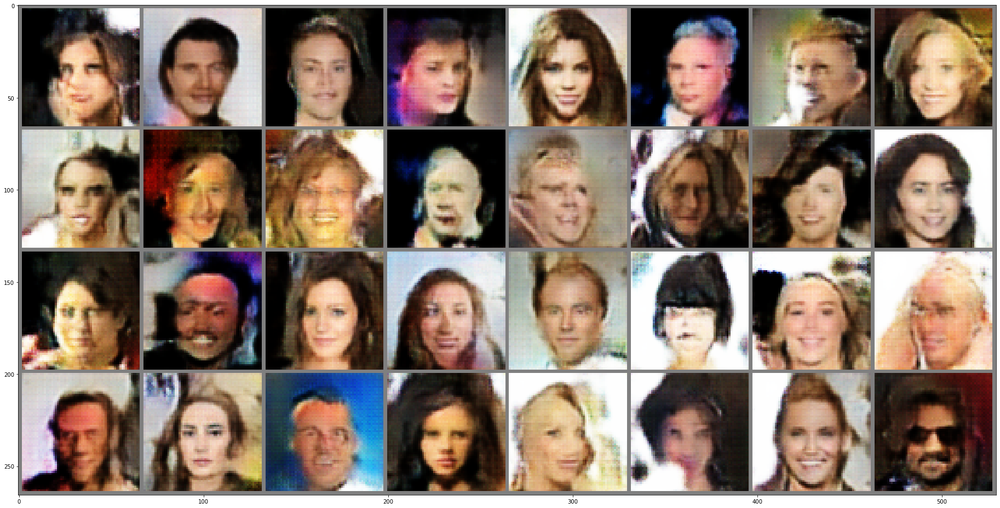

Step 20000: Generator loss: 141.47278153166488, critic loss: -26.433122355261524


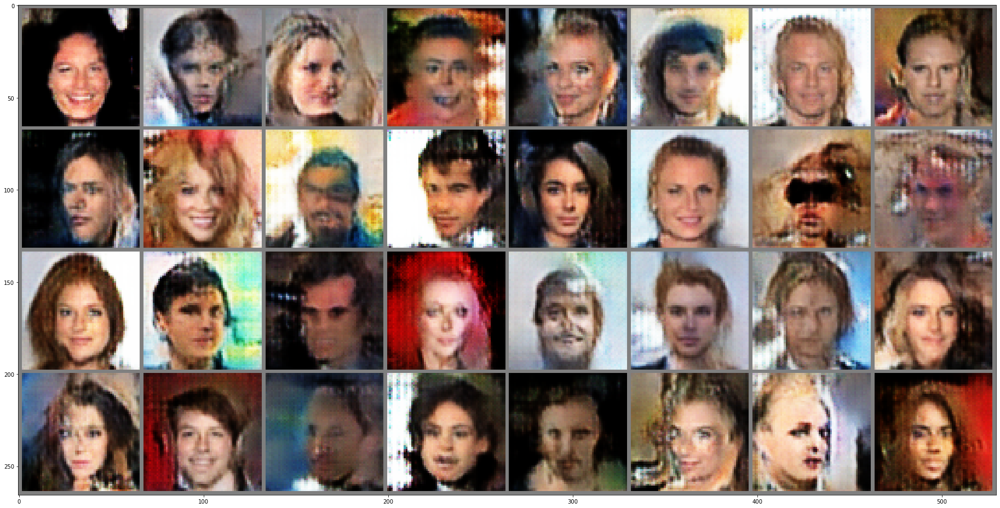


Epoch 15: Generator loss: 140.16688459951962, critic loss: -26.085755292141606


Step 20500: Generator loss: 139.59143648696573, critic loss: -25.93828519534043


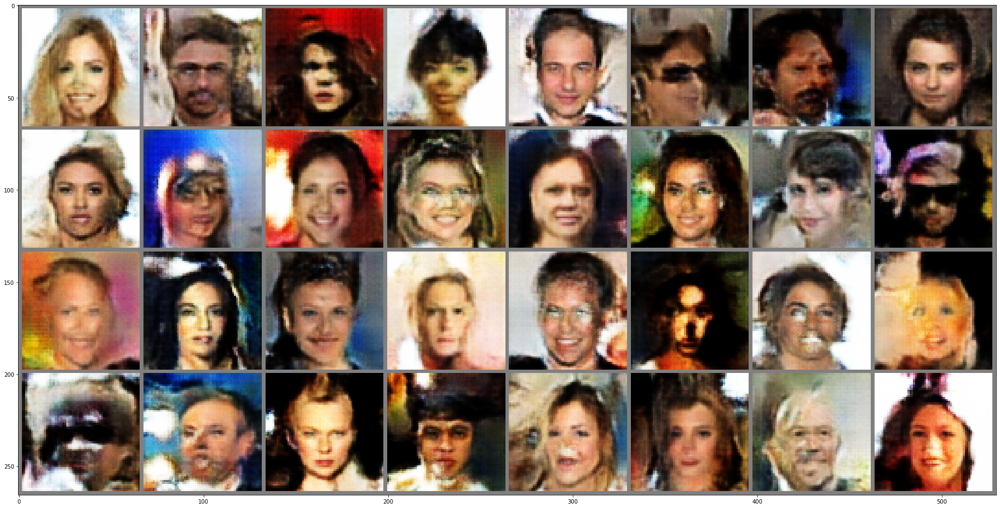

Step 21000: Generator loss: 137.89262941799322, critic loss: -25.461157938225607


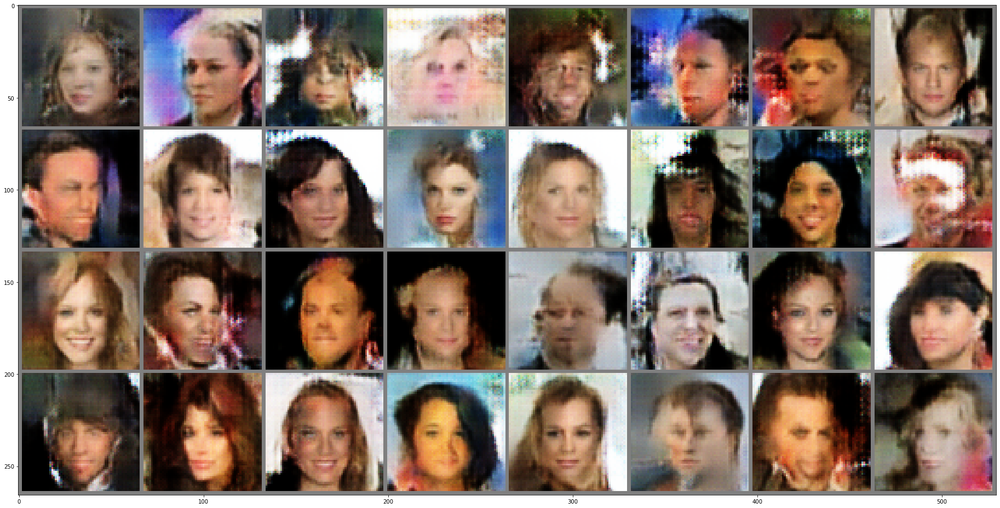

Step 21500: Generator loss: 136.54745603045154, critic loss: -24.896725199723313


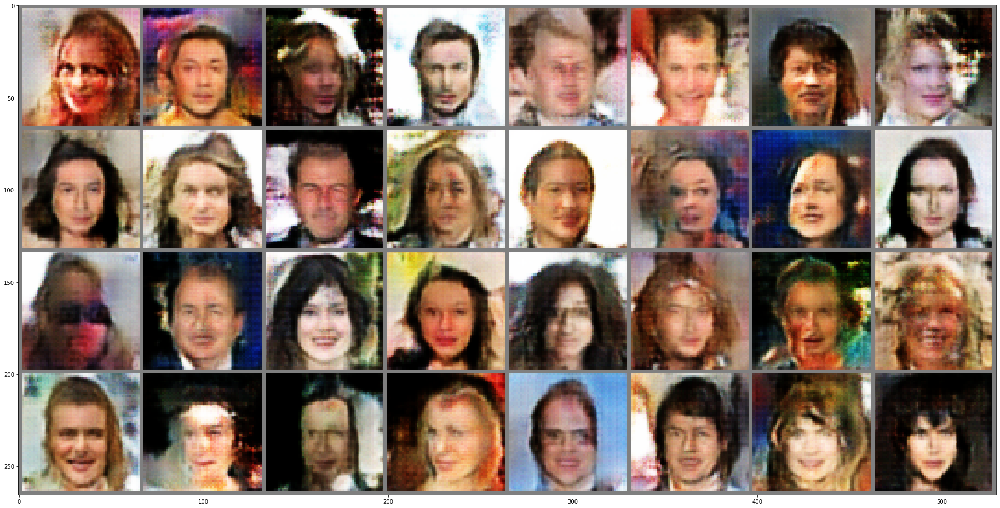


Epoch 16: Generator loss: 136.2356436592365, critic loss: -24.76262757034717


Step 22000: Generator loss: 135.29912076323637, critic loss: -24.36442541868869


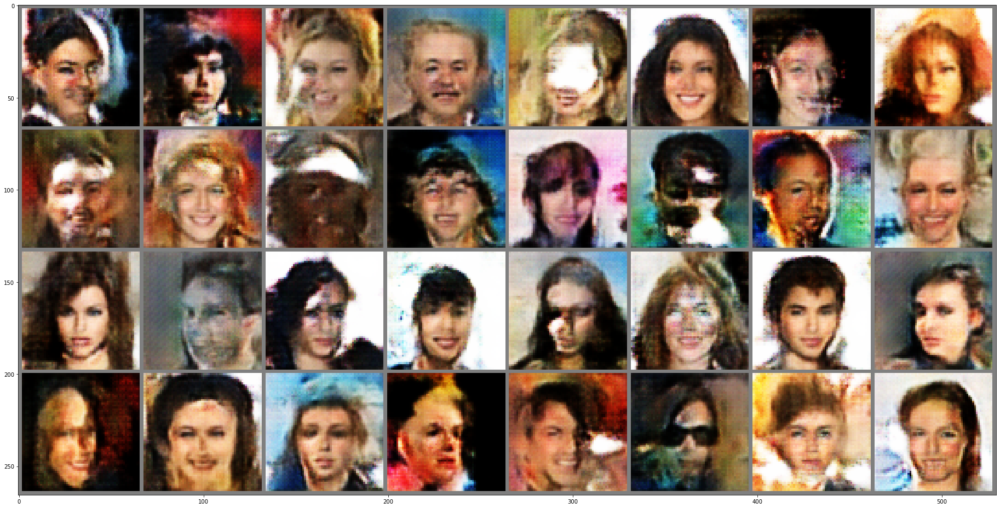

Step 22500: Generator loss: 134.15077361604895, critic loss: -23.867882371345665


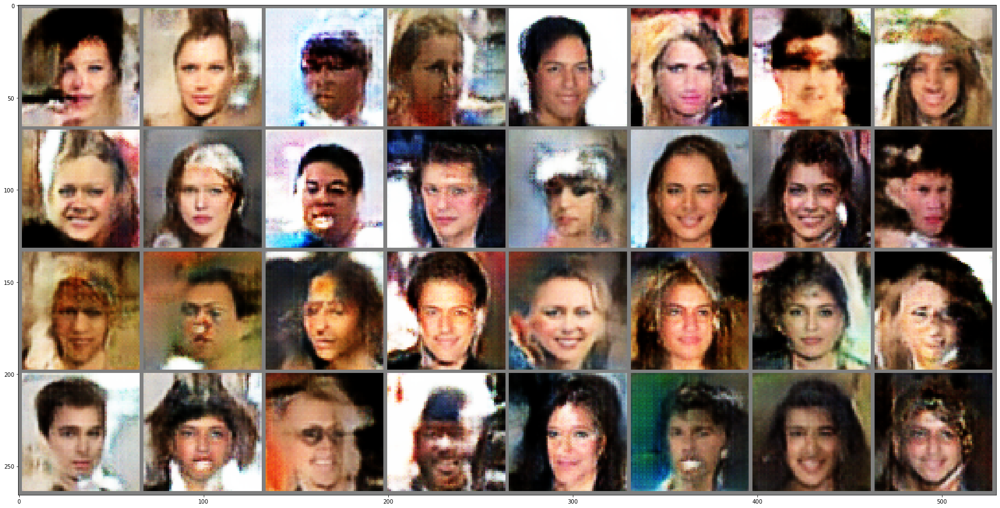


Epoch 17: Generator loss: 133.36840914991268, critic loss: -23.508956972167027


Step 23000: Generator loss: 133.16746197928924, critic loss: -23.4185748841286


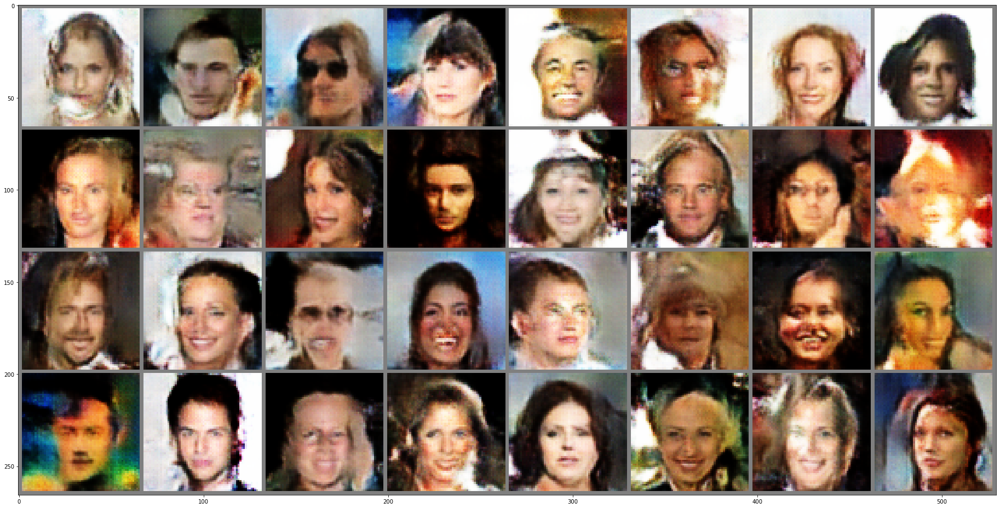

Step 23500: Generator loss: 132.22418907666457, critic loss: -23.016940584289134


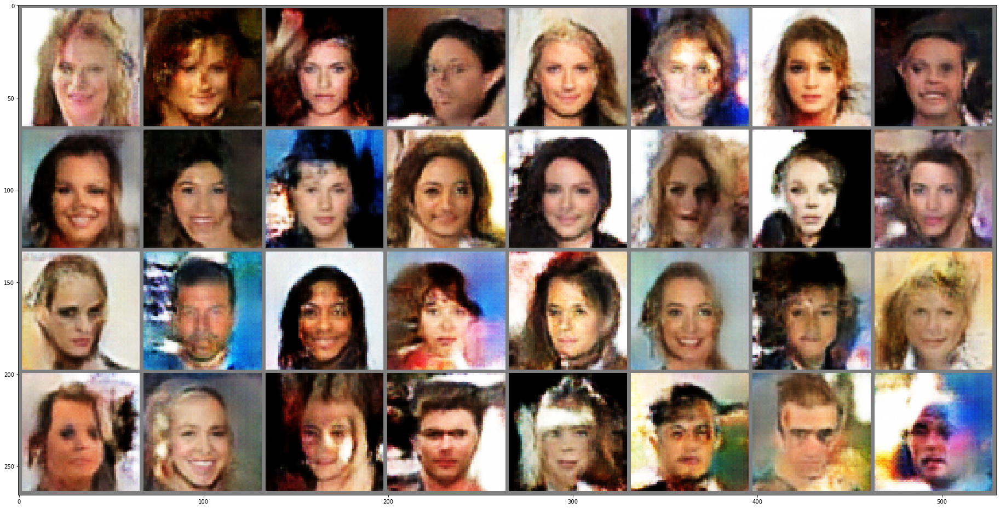

Step 24000: Generator loss: 131.1939284703282, critic loss: -22.664141733813526


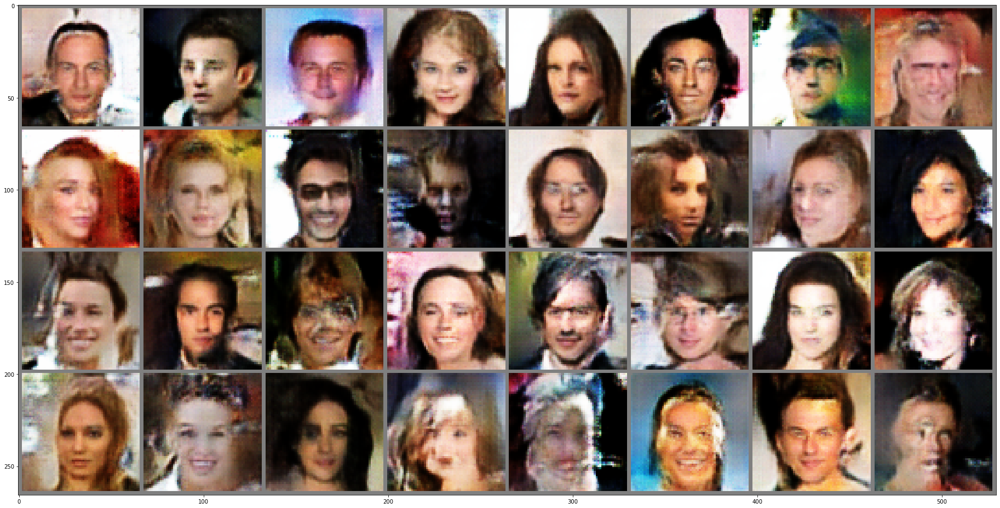


Epoch 18: Generator loss: 130.82529454179397, critic loss: -22.545192203315338


Step 24500: Generator loss: 130.04992329031288, critic loss: -22.319361312284645


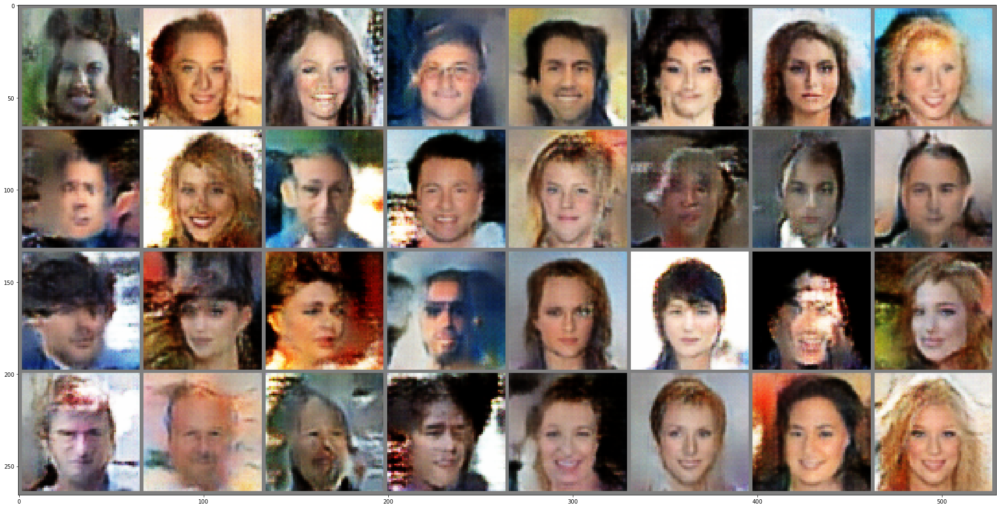

Step 25000: Generator loss: 128.9481810213928, critic loss: -21.985022100523388


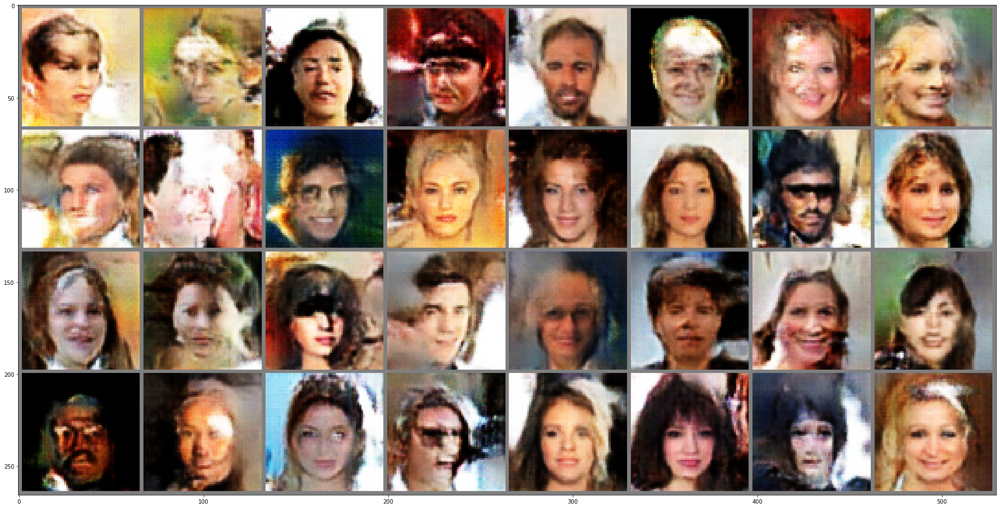


Epoch 19: Generator loss: 127.90042163595533, critic loss: -21.698850719804675


Step 25500: Generator loss: 127.7211932990819, critic loss: -21.652757495314752


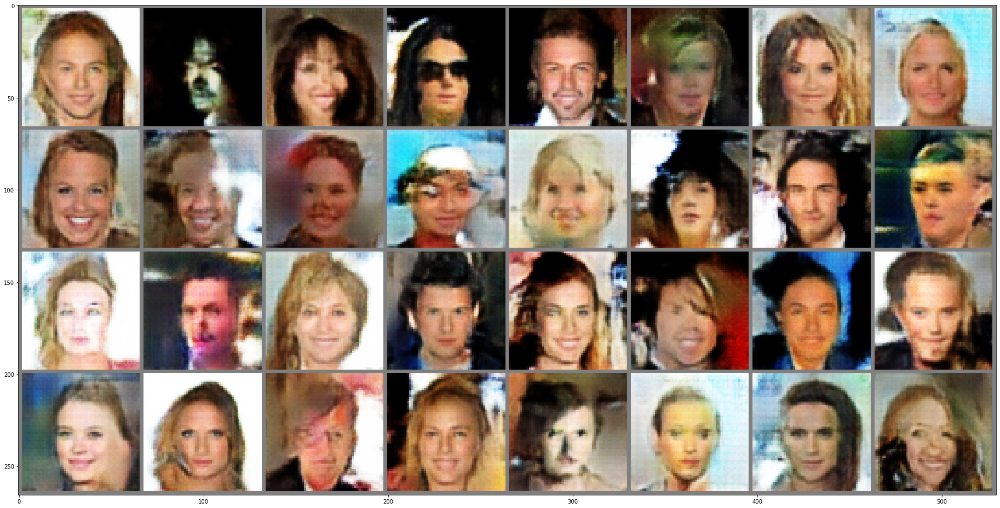

Step 26000: Generator loss: 126.47885506799041, critic loss: -21.33696060765691


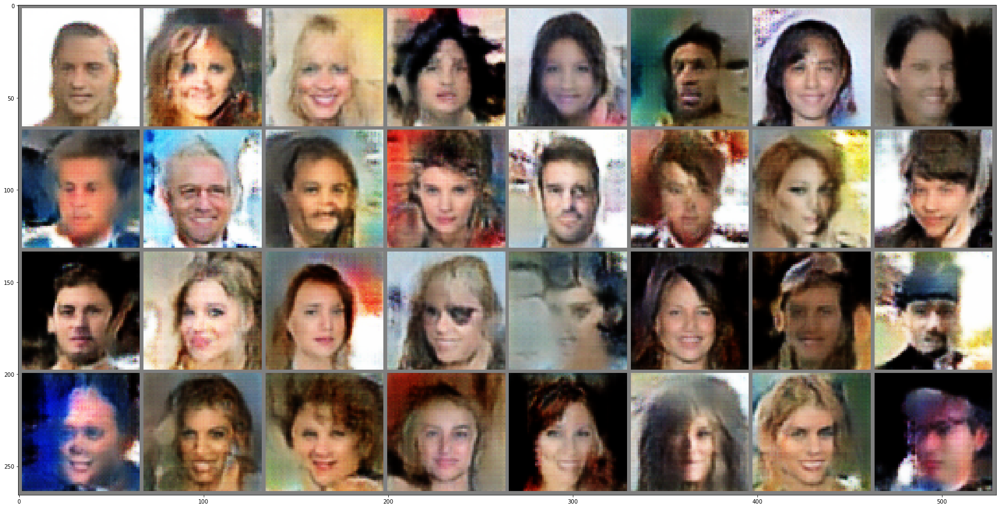

Step 26500: Generator loss: 125.43181763463714, critic loss: -20.96248740323184


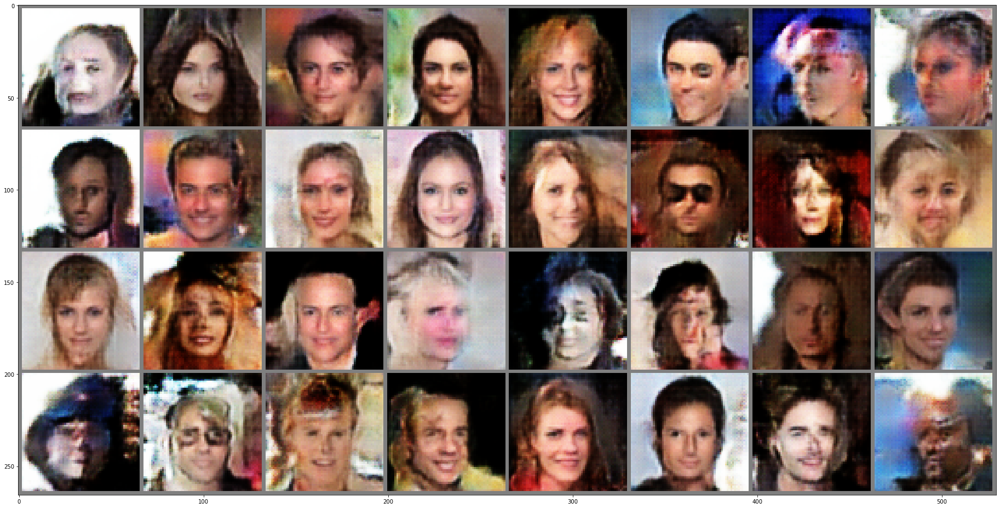


Epoch 20: Generator loss: 125.04258968741816, critic loss: -20.82130258964716


Step 27000: Generator loss: 124.52551384714417, critic loss: -20.657867983295613


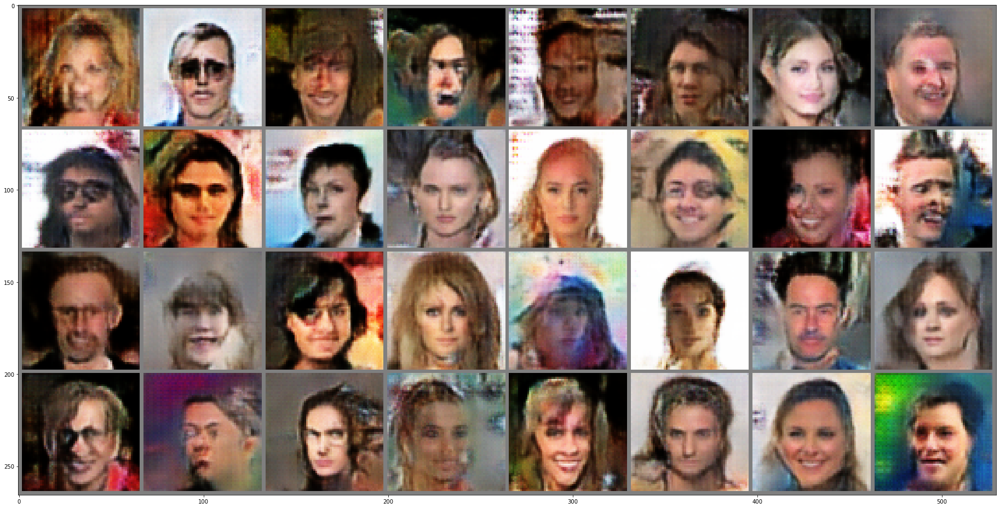

Step 27500: Generator loss: 123.63077317427813, critic loss: -20.388686414842784


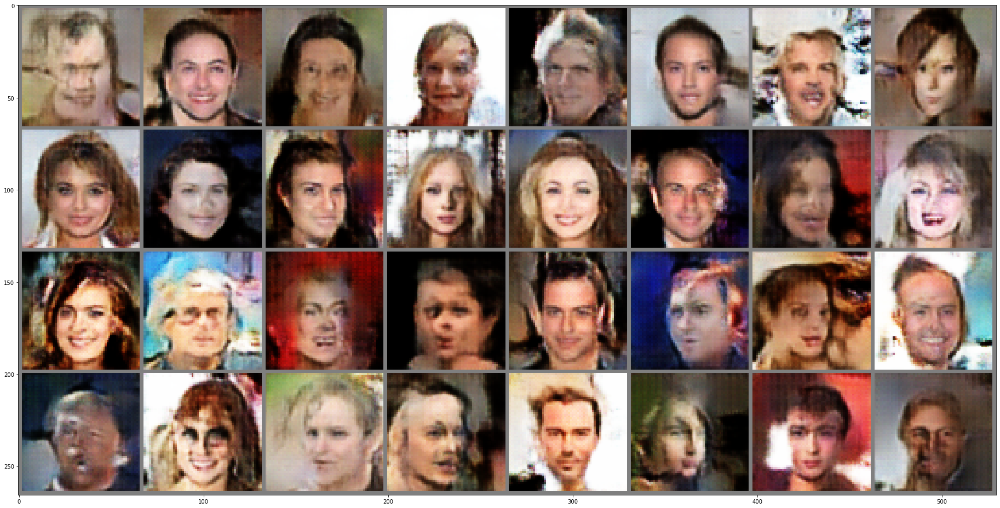


Epoch 21: Generator loss: 122.60221199438125, critic loss: -20.087744799587178


Step 28000: Generator loss: 122.55972367488577, critic loss: -20.07710122203482


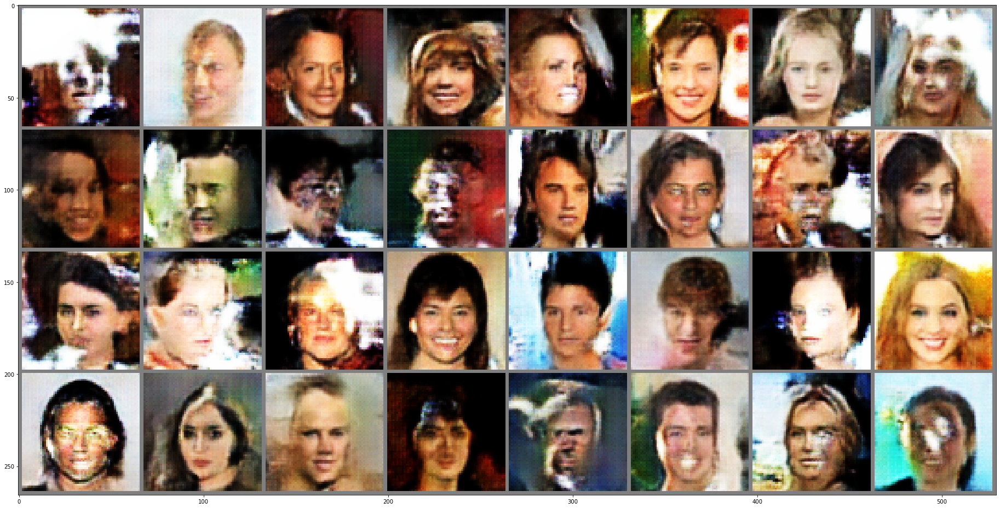

Step 28500: Generator loss: 121.44464171255261, critic loss: -19.798089989444865


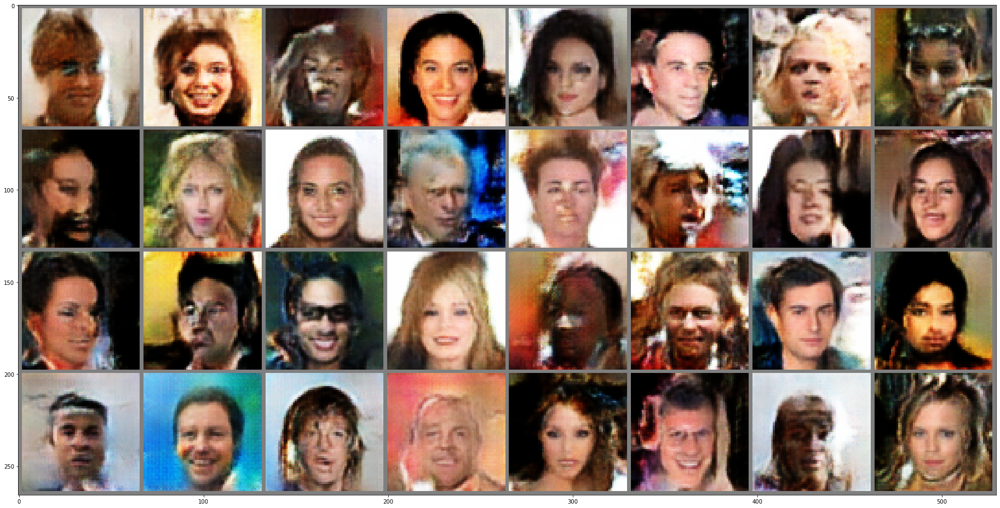

Step 29000: Generator loss: 120.34477342194472, critic loss: -19.551308620570676


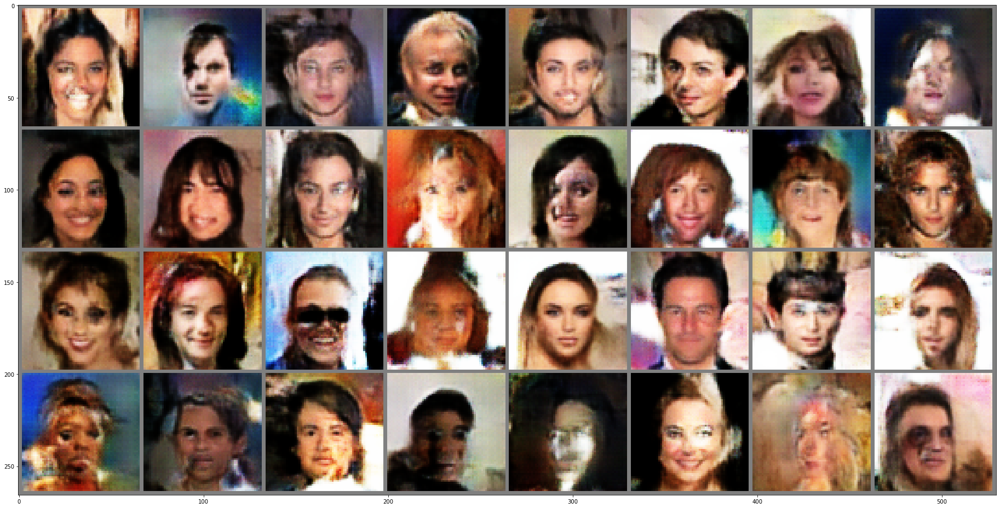


Epoch 22: Generator loss: 119.82302595734478, critic loss: -19.433757713257783


Step 29500: Generator loss: 119.35149143317881, critic loss: -19.299696370136825


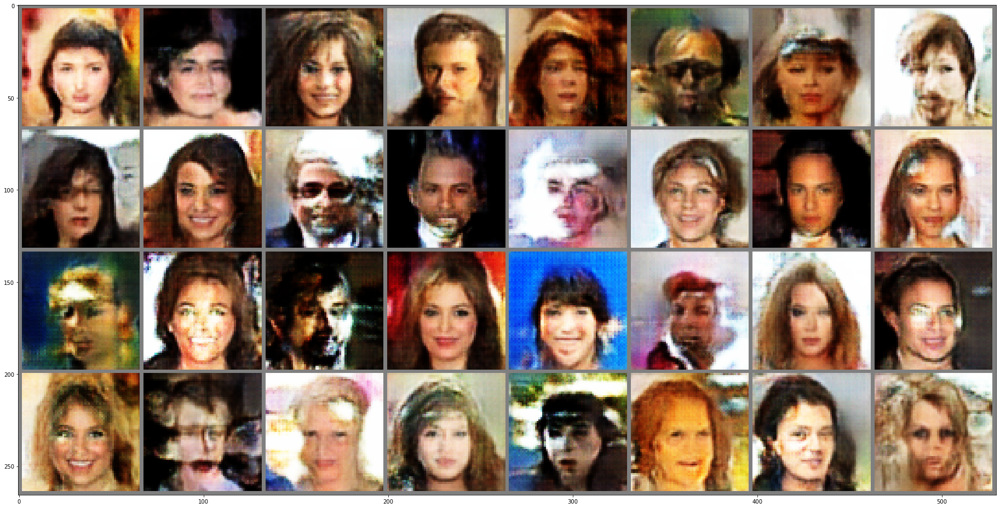

Step 30000: Generator loss: 118.4853379399168, critic loss: -19.036267103574026


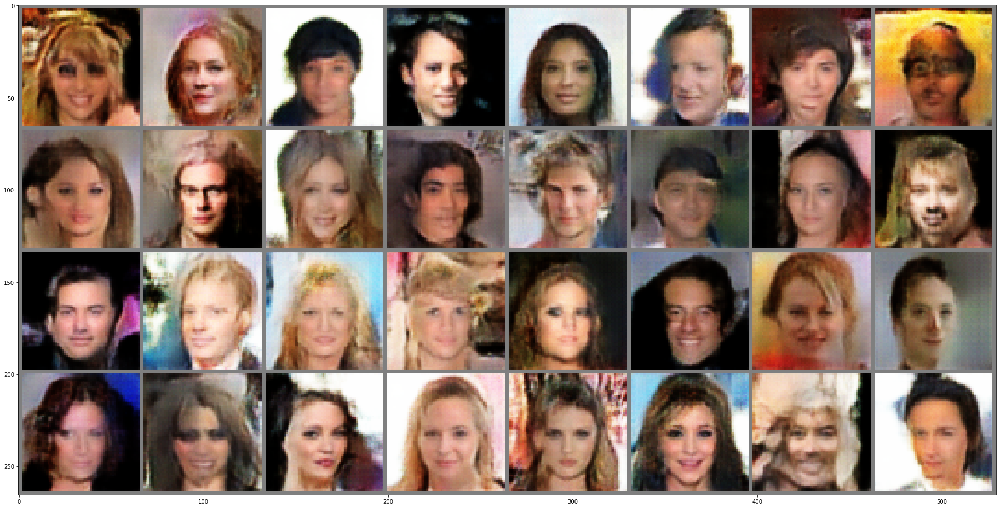

Step 30500: Generator loss: 117.63715455065369, critic loss: -18.783899235665846


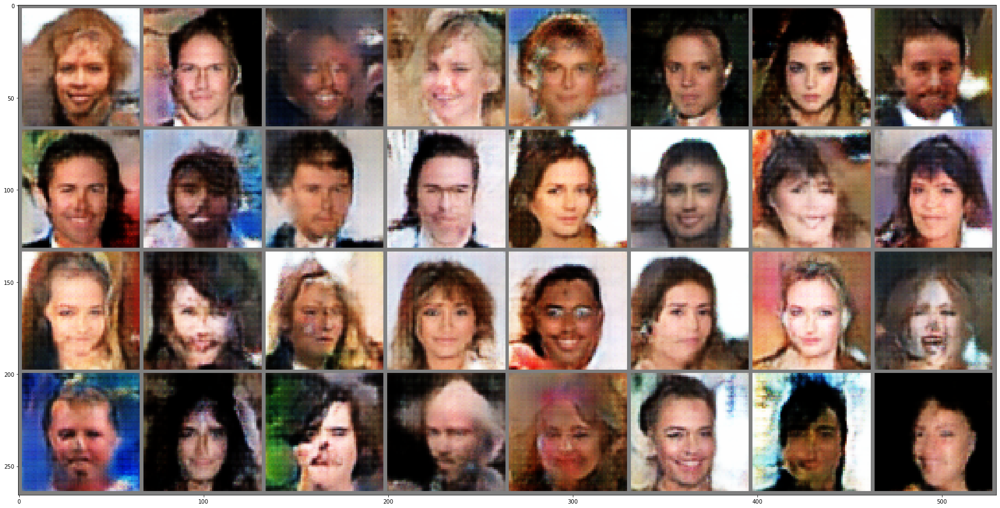


Epoch 23: Generator loss: 117.59590318894917, critic loss: -18.768820899492248


Step 31000: Generator loss: 116.86565946958946, critic loss: -18.513036749781534


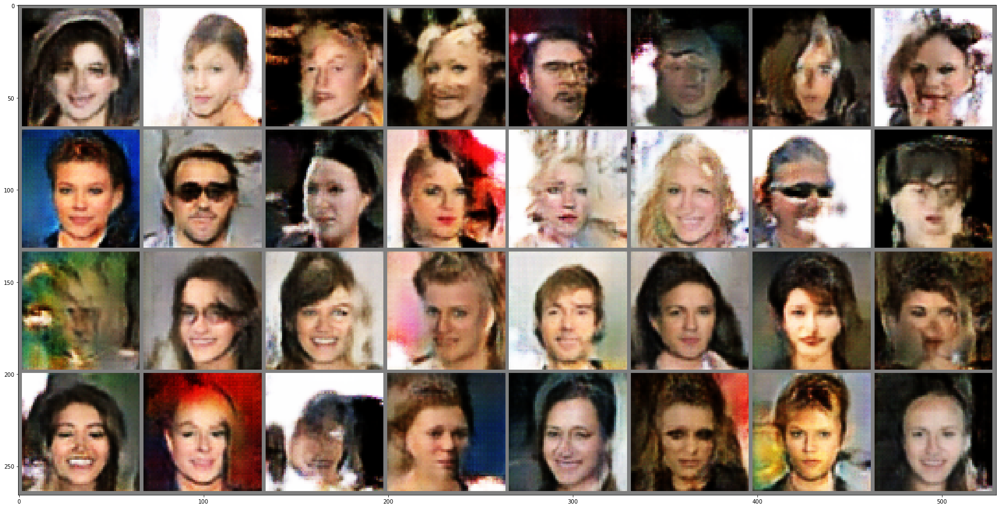

Step 31500: Generator loss: 116.1931553406204, critic loss: -18.27663020619969


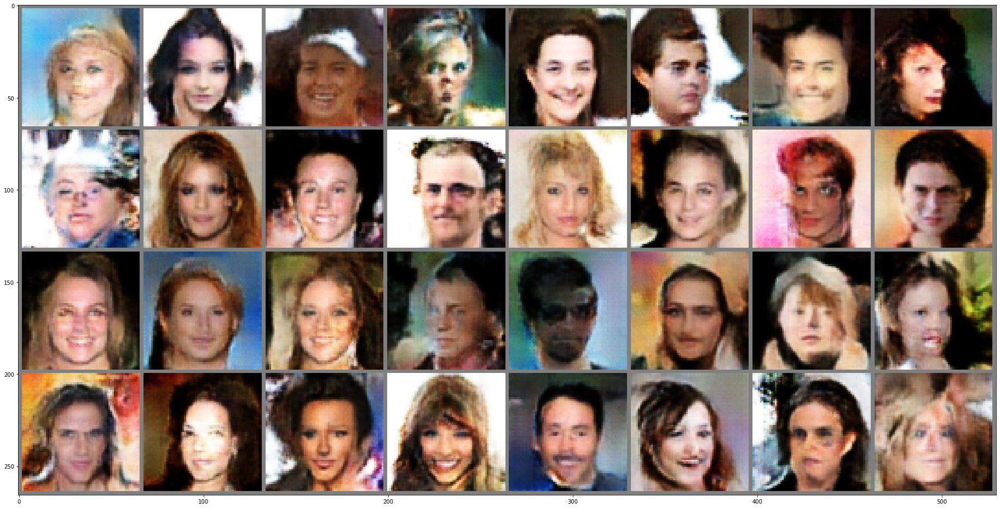


Epoch 24: Generator loss: 115.79479487350285, critic loss: -18.15694567472709


Step 32000: Generator loss: 115.49108236939766, critic loss: -18.085515754673658


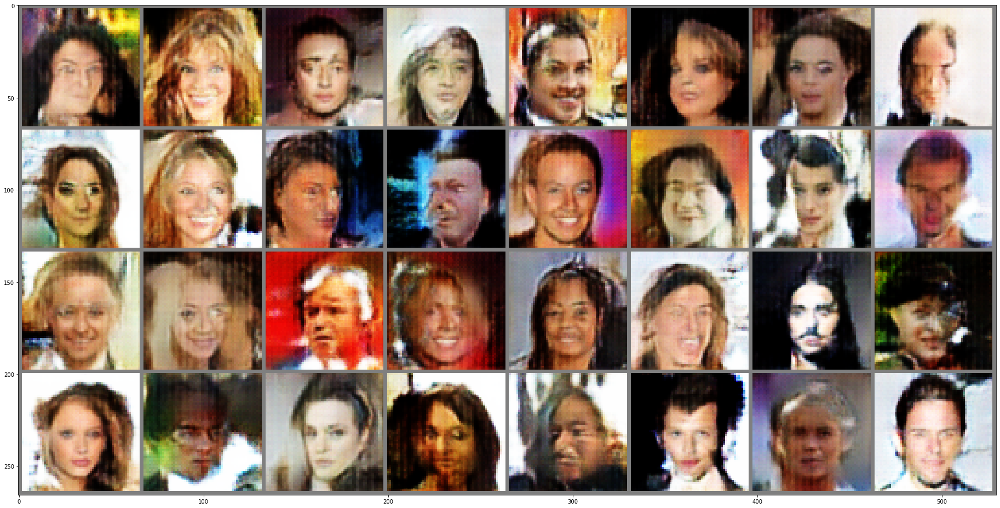

Step 32500: Generator loss: 114.69284968267723, critic loss: -17.869147278960835


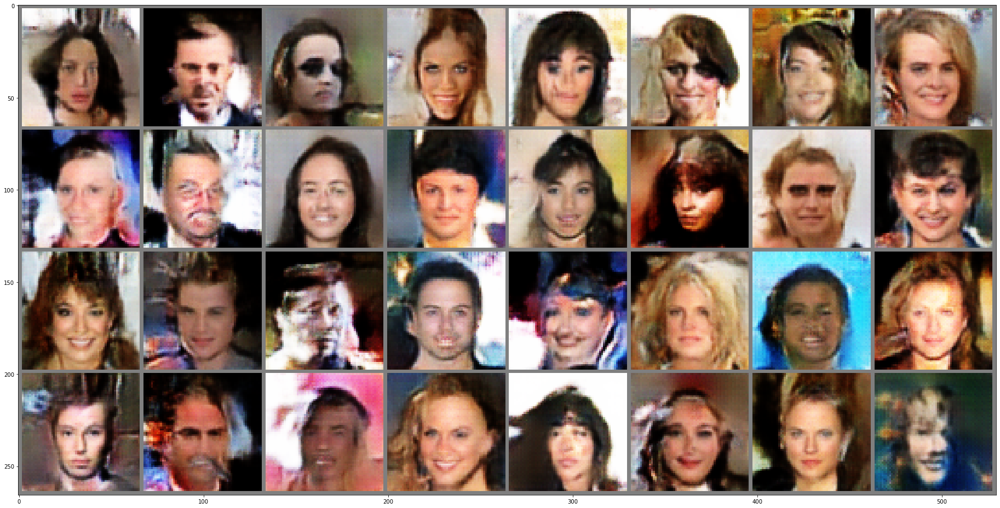

Step 33000: Generator loss: 114.00708647162153, critic loss: -17.683186565370274


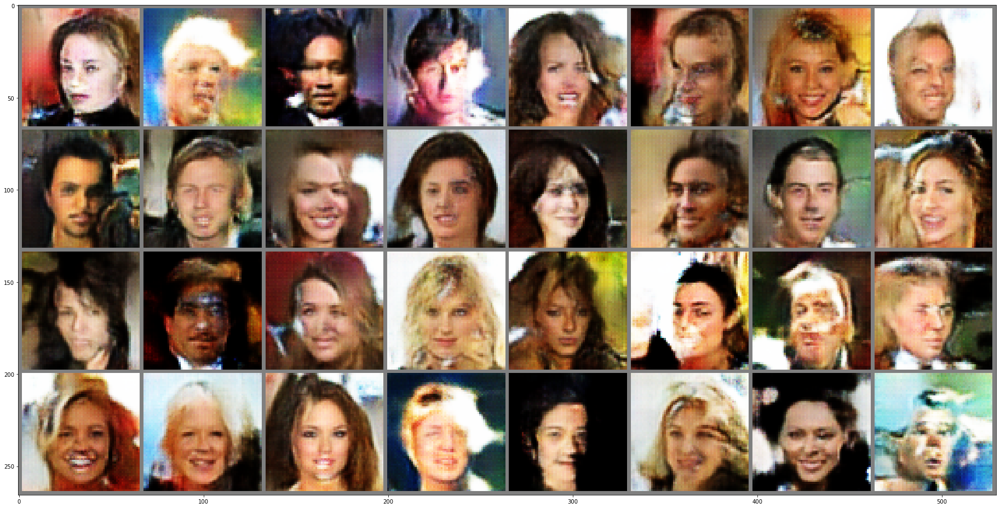


Epoch 25: Generator loss: 113.91134163574029, critic loss: -17.65977450878069


Step 33500: Generator loss: 113.40748054870589, critic loss: -17.446157846007694


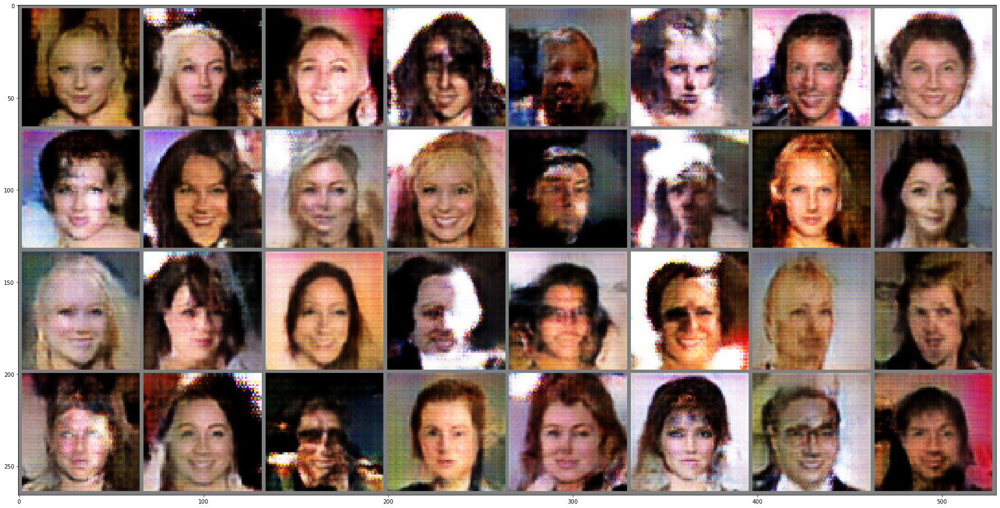

Step 34000: Generator loss: 112.94041829333294, critic loss: -17.203072823786933


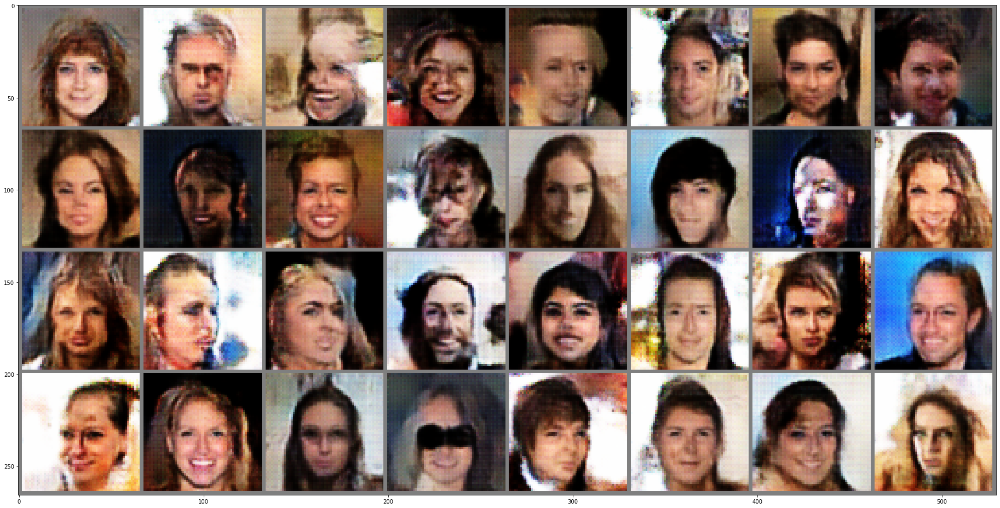


Epoch 26: Generator loss: 112.6460524917031, critic loss: -17.041442479625914


Step 34500: Generator loss: 112.50748582322136, critic loss: -16.96934760990151


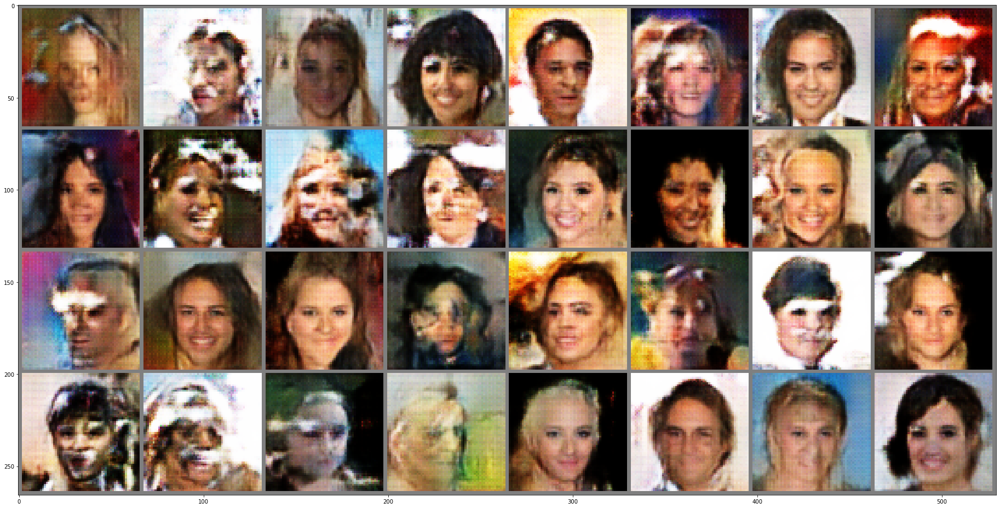

Step 35000: Generator loss: 112.1077357270036, critic loss: -16.74577573758137


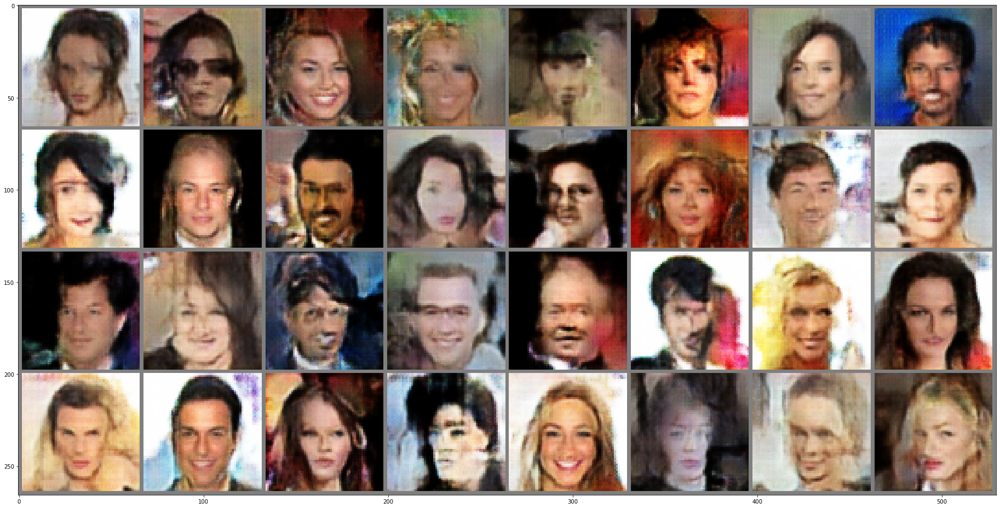

Step 35500: Generator loss: 111.77018561783365, critic loss: -16.534405003064574


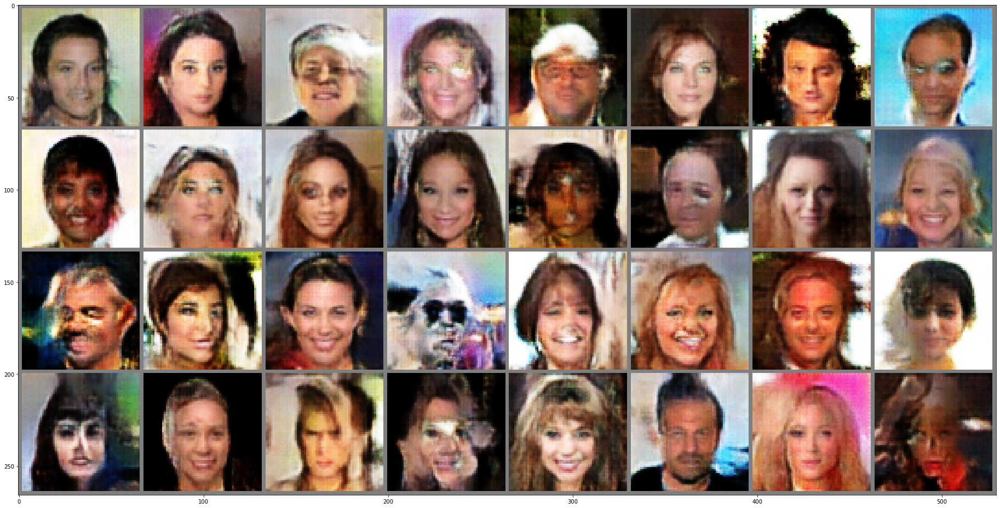


Epoch 27: Generator loss: 111.70170463805826, critic loss: -16.488202970912155


Step 36000: Generator loss: 111.47962747799401, critic loss: -16.33982351394513


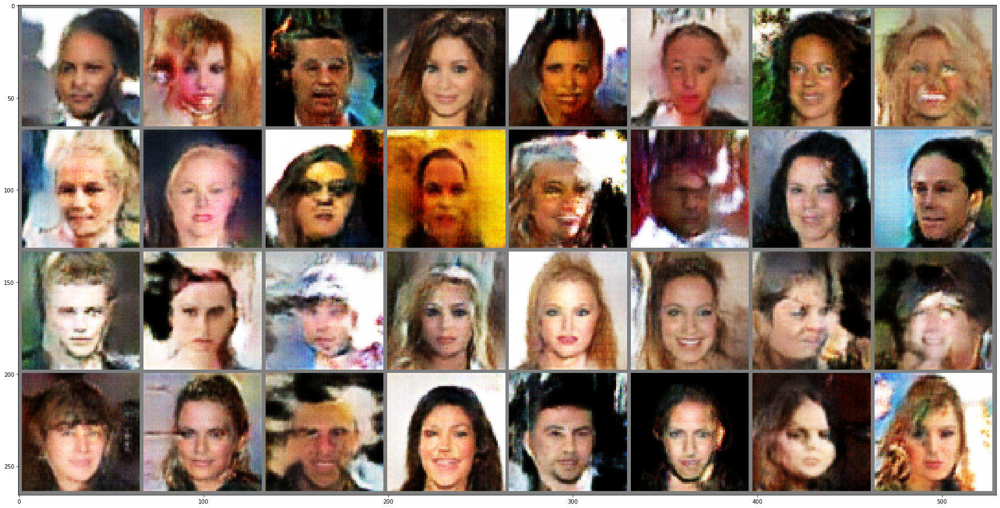

Step 36500: Generator loss: 111.1973279154166, critic loss: -16.1602008347049


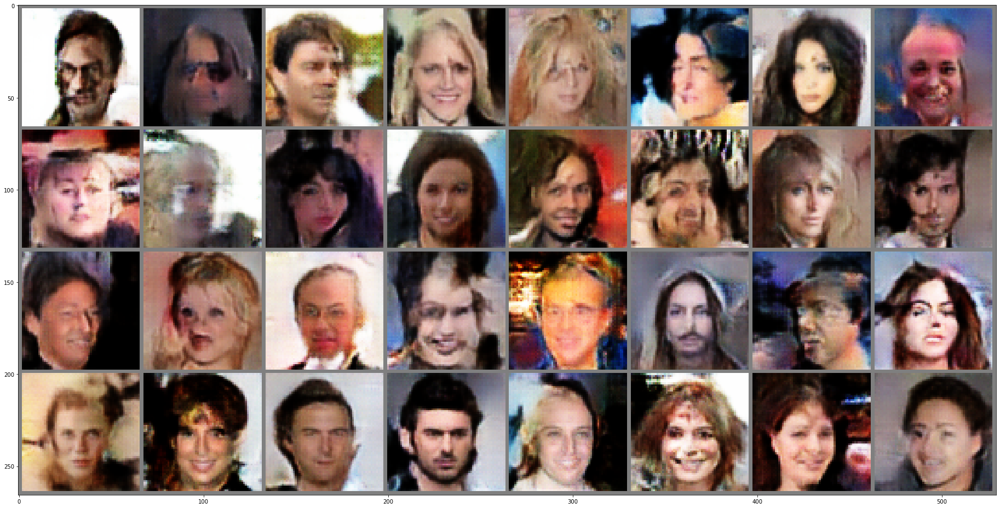


Epoch 28: Generator loss: 110.9797340727978, critic loss: -16.034112500541234


Step 37000: Generator loss: 110.91133802643398, critic loss: -15.99953833111467


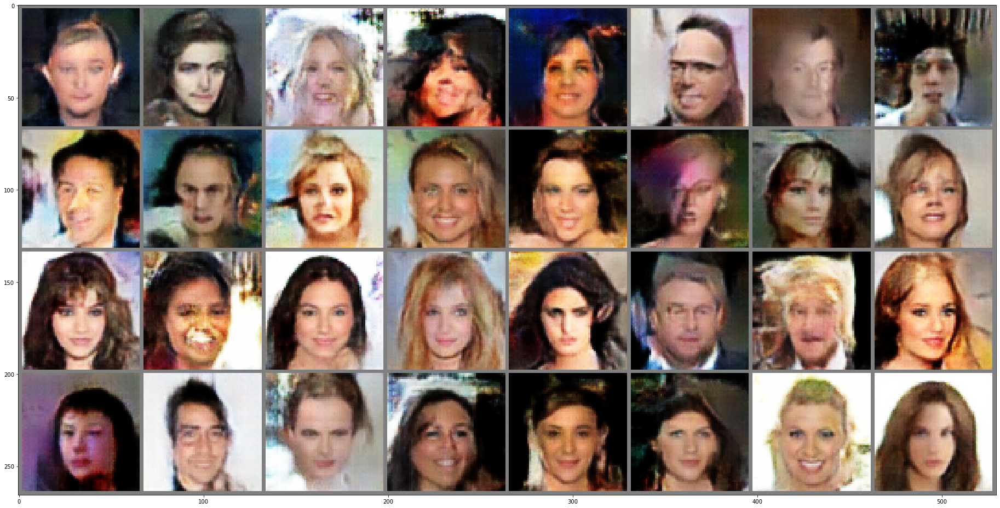

Step 37500: Generator loss: 110.6101691161854, critic loss: -15.861307072645735


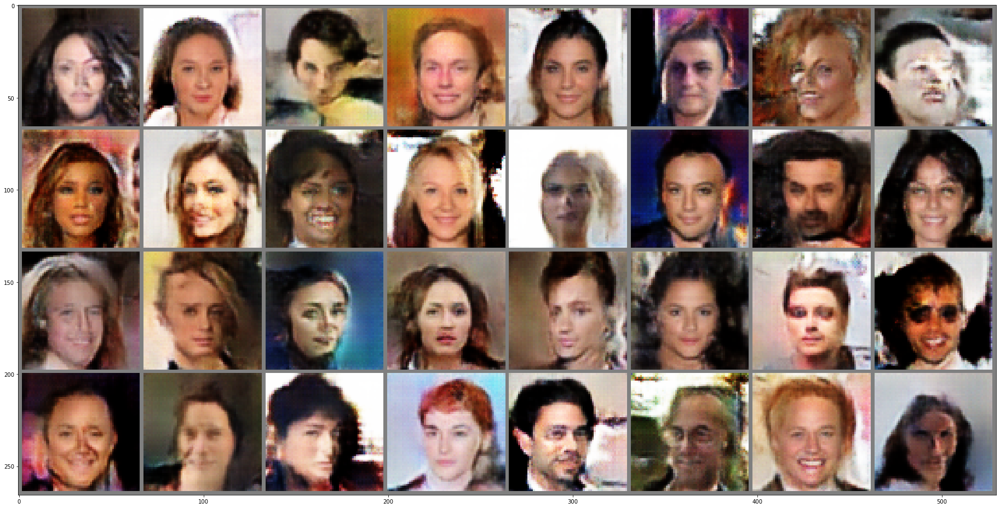

Step 38000: Generator loss: 110.25740838239587, critic loss: -15.688315700514286


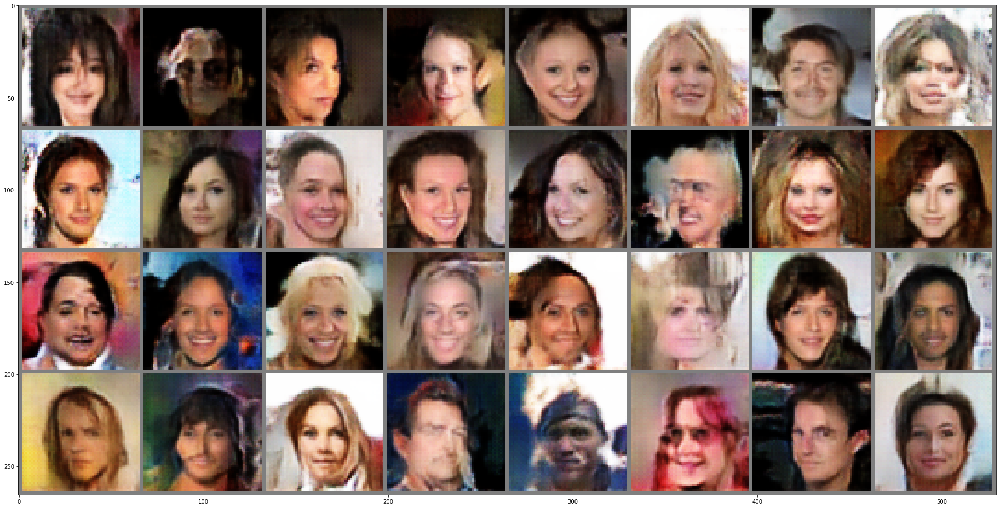

KeyboardInterrupt: 

In [17]:
generator.train()
critic.train()

generator_avg_loss = AverageMeter()
critic_avg_loss = AverageMeter()
static_noise = torch.randn(32, z_dim, 1, 1, device=device)
cur_step=0
for epoch in range(n_epochs):
    for real_images, _ in tqdm(dataloader):
        real_images = real_images.to(device)
        current_bs = len(real_images)
        
        # Train critic
        critic.zero_grad()
        noise = torch.randn(current_bs, z_dim, 1, 1, device=device).float()
        fake_images = generator(noise)
        critic_fake_pred = critic(fake_images.detach()) # detach generator from graph
        critic_real_pred = critic(real_images)
        gp = calc_gp(critic, real_images, fake_images)
        critic_loss = torch.mean(critic_fake_pred) - torch.mean(critic_real_pred) + c_lambda*gp

        critic_avg_loss.update(critic_loss.item(), current_bs)

        critic_loss.backward() 
        critic_opt.step()

        if cur_step % n_critic == 0:
            # Train generator
            gen_opt.zero_grad()
            noise = torch.randn(current_bs, z_dim, 1, 1, device=device).float()
            fake_images = generator(noise)
            critic_fake_pred = critic(fake_images)
            gen_loss = -torch.mean(critic_fake_pred)

            generator_avg_loss.update(gen_loss.item(), current_bs)

            gen_loss.backward()
            gen_opt.step()

        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Step {cur_step}: Generator loss: {generator_avg_loss.avg}, critic loss: {critic_avg_loss.avg}")
            with torch.no_grad():
                fake_images = generator(torch.randn(32, z_dim, 1, 1, device=device))
            mymshow(utils.make_grid(fake_images,nrow=8), std, mean,[32,32])
        cur_step += 1
        
    print(f"Epoch {epoch}: Generator loss: {generator_avg_loss.avg}, critic loss: {critic_avg_loss.avg}")
    with torch.no_grad():
        fake_images = generator(static_noise)
    save_image(utils.make_grid(fake_images,nrow=8), f'wgan_gif/celeba_wgan_epoch_{epoch}.jpg', normalize=True)
    

In [ ]:
torch.save(generator.state_dict(), 'generator_wgan_celeba.pt')

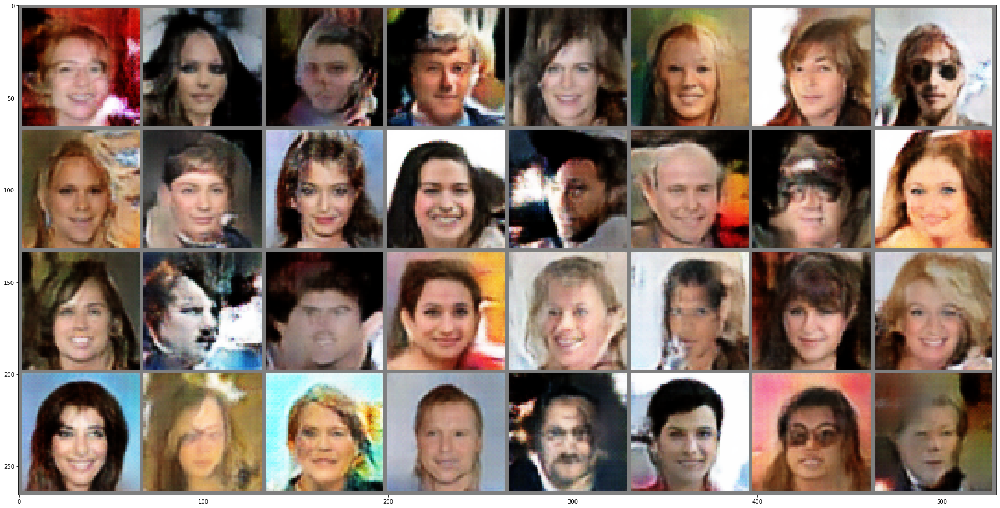

In [19]:
with torch.no_grad():
    fake_images = generator(torch.randn(32, z_dim, 1, 1, device=device))
mymshow(utils.make_grid(fake_images,nrow=8), std, mean,[32,32])